# Importar librerias

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import matplotlib.patches as patches
import timeit
from joblib import Parallel, delayed
import multiprocessing

# Funciones

In [ ]:
#from libreria import *

In [2]:
#-----------------------VARIABLES GLOBALES--------------------
TAM_PARCHE=128
TAM_PARCHE_MITAD=64
#-----------------------FUNCION PARA OBTENER EL NOMBRE DE ARCHIVO SEGUN SU NUMERO
#Esta funcion debe cambiarse en caso de usar otro dataset de imagenes
def getNombreArchivo(num):
    #rellenar con ceros a la izquierda
    cad=str(num).rjust(3,'0')
    return 'im_'+cad
#-----------------------------------------------------------------------------------------------------------

#---------------------------FUNCION DE AUMENTO DE DATOS, reflejo horizontal y vertical
def aumentar_datos(xposini,xposfin,xcarpeta_img_original,xcarpeta_img):
    xini=xposfin
    for i in range(xposini,xposfin):
        img = cv2.imread(xcarpeta_img_original+'/'+getNombreArchivo(i)+'.png')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+'.png',img)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(xini)+'.png',cv2.flip(img,0))
        xini=xini+1
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(xini)+'.png',cv2.flip(img,1))
        xini=xini+1

#---------------------------FUNCION INICIAL DE PROCESAMIENTO DE IMAGENES
#Procesa las imagenes originales, convirtiendolas a color y en grises escaladas un multiplo de TAM_PARCHE,
#y construyendo las imagenes reducidas un factor de 2x, 4x y 6x. Y tambien aplicando filtro desenfoque.
#def procesar_imagenes(xposini,xposfin,xcarpeta_img_original,xcarpeta_img,xnom_img1,xnom_img1color,xnom_img2,xnom_img2color,xnom_img3,xnom_img3color,xnom_img4,xnom_img4color,xnom_img5,xnom_img5color,xnom_img7,xnom_img7color,xnom_img8,xnom_img8color,xnom_img9,xnom_img9color,xnom_img6,xnom_img6color):
#def procesar_imagenes(xposini,xposfin,xcarpeta_img_original,xcarpeta_img,xnom_img1,xnom_img1color,xnom_img2,xnom_img2color,xnom_img3,xnom_img3color,xnom_img4,xnom_img4color,xnom_img5,xnom_img5color,xnom_img7,xnom_img7color,xnom_img8,xnom_img8color,xnom_img9,xnom_img9color):
def procesar_imagenes(xposini,xposfin,xcarpeta_img_original,xcarpeta_img,xnom_img1,xnom_img1color,xnom_img2,xnom_img2color,xnom_img3,xnom_img3color,xnom_img4,xnom_img4color,xnom_img5,xnom_img5color):
    for i in range(xposini,xposfin):
        img = cv2.imread(xcarpeta_img_original+'/'+getNombreArchivo(i)+'.png')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        #Redimensionar a multiplo TAM_PARCHExTAM_PARCHE
        tamsegy=int(img.shape[0]/TAM_PARCHE)+1
        tamsegx=int(img.shape[1]/TAM_PARCHE)+1
        nuevoy=tamsegy*TAM_PARCHE
        nuevox=tamsegx*TAM_PARCHE
        img2 = cv2.resize(img, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        #Convertir a grises y guardar
        r,g,b=img2[:,:,0],img2[:,:,1],img2[:,:,2]
        egrises=0.2989*r+0.5870*g+0.1140*b
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img1+'.png',egrises,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img1color+'.png',img2)

        #----------Reducir a la mitad 2x y reescalada a 2x
        img3 = cv2.resize(egrises, dsize=(int(nuevox/2),int(nuevoy/2)), interpolation=cv2.INTER_CUBIC)
        img4 = cv2.resize(img3, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img3nearest = cv2.resize(egrises, dsize=(int(nuevox/2),int(nuevoy/2)), interpolation=cv2.INTER_NEAREST)
        img4nearest = cv2.resize(img3nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2+'r2.png',img3,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2+'.png',img4,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2+'nearest.png',img4nearest,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2+'nearestblur.png',cv2.blur(img4nearest,(5,5)),cmap='gray')
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img7+'.png',cv2.blur(img4,(5,5)),cmap='gray')
        img3 = cv2.resize(img2, dsize=(int(nuevox/2),int(nuevoy/2)), interpolation=cv2.INTER_CUBIC)
        img4 = cv2.resize(img3, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img3nearest = cv2.resize(img2, dsize=(int(nuevox/2),int(nuevoy/2)), interpolation=cv2.INTER_NEAREST)
        img4nearest = cv2.resize(img3nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2color+'r2.png',img3)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2color+'.png',img4)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2color+'nearest.png',img4nearest)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img2color+'nearestblur.png',cv2.blur(img4nearest,(5,5)))
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img7color+'.png',cv2.blur(img4,(5,5)))


        #----------Reducir a la cuarta 4x y reescalada a 4x
        img5 = cv2.resize(egrises, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_CUBIC)
        img6 = cv2.resize(img5, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img5nearest = cv2.resize(egrises, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_NEAREST)
        img6nearest = cv2.resize(img5nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3+'r4.png',img5,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3+'.png',img6,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3+'nearest.png',img6nearest,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3+'nearestblur.png',cv2.blur(img6nearest,(5,5)),cmap='gray')
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img8+'.png',cv2.blur(img6,(5,5)),cmap='gray')
        img5 = cv2.resize(img2, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_CUBIC)
        img6 = cv2.resize(img5, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img5nearest = cv2.resize(img2, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_NEAREST)
        img6nearest = cv2.resize(img5nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3color+'r4.png',img5)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3color+'.png',img6)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3color+'nearest.png',img6nearest)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3color+'nearestblur.png',cv2.blur(img6nearest,(5,5)))
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img8color+'.png',cv2.blur(img6,(5,5)))

        #----------Reducir a la sexta 6x y reescalada a 6x
        img7 = cv2.resize(egrises, dsize=(int(nuevox/6),int(nuevoy/6)), interpolation=cv2.INTER_CUBIC)
        img8 = cv2.resize(img7, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img7nearest = cv2.resize(egrises, dsize=(int(nuevox/6),int(nuevoy/6)), interpolation=cv2.INTER_NEAREST)
        img8nearest = cv2.resize(img7nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4+'r6.png',img7,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4+'.png',img8,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4+'nearest.png',img8nearest,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4+'nearestblur.png',cv2.blur(img8nearest,(5,5)),cmap='gray')
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img9+'.png',cv2.blur(img8,(5,5)),cmap='gray')
        img7 = cv2.resize(img2, dsize=(int(nuevox/6),int(nuevoy/6)), interpolation=cv2.INTER_CUBIC)
        img8 = cv2.resize(img7, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img7nearest = cv2.resize(img2, dsize=(int(nuevox/6),int(nuevoy/6)), interpolation=cv2.INTER_NEAREST)
        img8nearest = cv2.resize(img7nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4color+'r6.png',img7)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4color+'.png',img8)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4color+'nearest.png',img8nearest)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img4color+'nearestblur.png',cv2.blur(img8nearest,(5,5)))
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img9color+'.png',cv2.blur(img8,(5,5)))

        #----------Desenfoque-----------
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img5+'.png',cv2.blur(egrises,(5,5)),cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img5color+'.png',cv2.blur(img2,(5,5)))

        #----------Ruido gaussiano
        #gs_img1 = skimage.io.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        #gs_img1_ruido = skimage.util.random_noise(gs_img1, mode='gaussian', var=0.003)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img6+'.png',gs_img1_ruido,cmap='gray')

        #gs_img1 = skimage.io.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img1color+'.png')
        #gs_img1_ruido = skimage.util.random_noise(gs_img1, mode='gaussian', var=0.003)
        #plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img6color+'.png',gs_img1_ruido)


#---------------------------FUNCIONES PARA EL AUTOMATA CELULAR
VG_VIVO=0
VG_MUERTO=255

def aleatorio(minimo,maximo):
    return round((np.random.rand()*(maximo-minimo))+minimo)

def contarVecinasSimilares(matAB,nfilas,ncolumnas,i,j,umbral):
    i=i+1
    j=j+1
    cont=0
    umin=matAB[i,j]-umbral
    umax=matAB[i,j]+umbral
    if((matAB[i-1,j-1]>=umin) and (matAB[i-1,j-1]<=umax)):
        cont=cont+1
    if((matAB[i-1,j]>=umin) and (matAB[i-1,j]<=umax)):
        cont=cont+1
    if((matAB[i-1,j+1]>=umin) and (matAB[i-1,j+1]<=umax)):
        cont=cont+1
    if((matAB[i+1,j-1]>=umin) and (matAB[i+1,j-1]<=umax)):
        cont=cont+1
    if((matAB[i+1,j]>=umin) and (matAB[i+1,j]<=umax)):
        cont=cont+1
    if((matAB[i+1,j+1]>=umin) and (matAB[i+1,j+1]<=umax)):
        cont=cont+1
    if((matAB[i,j-1]>=umin) and (matAB[i,j-1]<=umax)):
        cont=cont+1
    if((matAB[i,j+1]>=umin) and (matAB[i,j+1]<=umax)):
        cont=cont+1
    return cont

def contarVecinasVivas(matAB,nfilas,ncolumnas,i,j):
    i=i+1
    j=j+1
    cont=0
    if(matAB[i-1,j-1]==VG_VIVO):
        cont=cont+1
    if(matAB[i-1,j]==VG_VIVO):
        cont=cont+1
    if(matAB[i-1,j+1]==VG_VIVO):
        cont=cont+1
    if(matAB[i+1,j-1]==VG_VIVO):
        cont=cont+1
    if(matAB[i+1,j]==VG_VIVO):
        cont=cont+1
    if(matAB[i+1,j+1]==VG_VIVO):
        cont=cont+1
    if(matAB[i,j-1]==VG_VIVO):
        cont=cont+1
    if(matAB[i,j+1]==VG_VIVO):
        cont=cont+1
    return cont

#Version 6var: Aplica el autómata.Inicializando la (matrizA) con un estructura inicial de rejilla uniforme
#y con un umbral de distancia de intensidad de 3
def aplicar_automata6var(xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_mapimg,xnom_mapimg,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    for i in range(xposini,xposfin):
        egrises = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        egrises = cv2.cvtColor(egrises, cv2.COLOR_BGR2GRAY)

        original_nuevoy=int(egrises.shape[0])
        original_nuevox=int(egrises.shape[1])
        egrises = cv2.resize(egrises, dsize=(original_nuevox*2,original_nuevoy*2), interpolation=cv2.INTER_CUBIC)

        nuevoy=int(egrises.shape[0])
        nuevox=int(egrises.shape[1])
        #automata crear estructuras
        matrizI=np.copy(egrises)
        matrizA=np.copy(egrises)
        for y in range(0,nuevoy):
            for x in range(0,nuevox):
                #matrizA[y,x]=aleatorio(0,1)
                if y % 2 == 0 or x % 2 == 0:
                    matrizA[y,x]=1*255
                else:
                    matrizA[y,x]=0*255
        matrizI_AB=ampliarBordesImagen(matrizI, 1)
        #automata iterar maxsec veces
        for ra in range(0,maxsec):
            plt.imsave(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
            cop_matrizA=np.copy(matrizA)
            matrizA_AB=ampliarBordesImagen(matrizA, 1)
            for y in range(0,nuevoy):
                for x in range(0,nuevox):
                    numsimilares=contarVecinasSimilares(matrizI_AB,nuevoy,nuevox,y,x,3)
                    numvivas=contarVecinasVivas(matrizA_AB,nuevoy,nuevox,y,x)+numsimilares
                    if(matrizA[y,x]==VG_VIVO):
                        if numvivas<2:
                            if numsimilares>3:
                                cop_matrizA[y,x]=VG_MUERTO
                        else:
                            if(numvivas==2 or numvivas==3):
                                pass
                            else:
                                if numsimilares>3:
                                    cop_matrizA[y,x]=VG_MUERTO
                    else:
                        if numvivas==3:
                            if numsimilares<=3:
                                cop_matrizA[y,x]=VG_VIVO
            matrizA=np.copy(cop_matrizA)
        #guardar mapa
        #matrizA = cv2.resize(matrizA, dsize=(original_nuevox,original_nuevoy), interpolation=cv2.INTER_CUBIC)
        plt.imsave(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png',matrizA,cmap='gray',vmin=0, vmax=255)

def aplicar_automata6var_inverso(xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_mapimg,xnom_mapimg,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    for i in range(xposini,xposfin):
        egrises = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        egrises = cv2.cvtColor(egrises, cv2.COLOR_BGR2GRAY)

        original_nuevoy=int(egrises.shape[0])
        original_nuevox=int(egrises.shape[1])
        egrises = cv2.resize(egrises, dsize=(original_nuevox*2,original_nuevoy*2), interpolation=cv2.INTER_CUBIC)

        nuevoy=int(egrises.shape[0])
        nuevox=int(egrises.shape[1])
        #automata crear estructuras
        matrizI=np.copy(egrises)
        matrizA=np.copy(egrises)
        for y in range(0,nuevoy):
            for x in range(0,nuevox):
                #matrizA[y,x]=aleatorio(0,1)
                if y % 2 == 0 or x % 2 == 0:
                    matrizA[y,x]=1*255
                else:
                    matrizA[y,x]=0*255
        matrizI_AB=ampliarBordesImagen(matrizI, 1)
        #automata iterar maxsec veces
        for ra in range(0,maxsec):
            plt.imsave(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
            cop_matrizA=np.copy(matrizA)
            matrizA_AB=ampliarBordesImagen(matrizA, 1)
            for y in range(0,nuevoy):
                for x in range(0,nuevox):
                    numsimilares=8-contarVecinasSimilares(matrizI_AB,nuevoy,nuevox,y,x,3)
                    numvivas=contarVecinasVivas(matrizA_AB,nuevoy,nuevox,y,x)+numsimilares
                    if(matrizA[y,x]==VG_VIVO):
                        if numvivas<2:
                            if numsimilares>3:
                                cop_matrizA[y,x]=VG_MUERTO
                        else:
                            if(numvivas==2 or numvivas==3):
                                pass
                            else:
                                if numsimilares>3:
                                    cop_matrizA[y,x]=VG_MUERTO
                    else:
                        if numvivas==3:
                            if numsimilares<=3:
                                cop_matrizA[y,x]=VG_VIVO
            matrizA=np.copy(cop_matrizA)
        #guardar mapa
        #matrizA = cv2.resize(matrizA, dsize=(original_nuevox,original_nuevoy), interpolation=cv2.INTER_CUBIC)
        plt.imsave(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png',matrizA,cmap='gray',vmin=0, vmax=255)

def combinar_automata6var(xposini,xposfin,xcarpeta_mapimg,xnom_mapimg,xcarpeta_mapimg_inv,xnom_mapimg_inv,xcarpeta_mapimg_comb,xnom_mapimg_comb):
    for i in range(xposini,xposfin):
        #egrises = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        #egrises = cv2.cvtColor(egrises, cv2.COLOR_BGR2GRAY)

        xmapa=cv2.imread(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png')
        xmapa=cv2.cvtColor(xmapa, cv2.COLOR_BGR2GRAY)

        nuevoy=int(xmapa.shape[0])
        nuevox=int(xmapa.shape[1])

        xmapa_inv=cv2.imread(xcarpeta_mapimg_inv+'/'+getNombreArchivo(i)+xnom_mapimg_inv+'.png')
        xmapa_inv=cv2.cvtColor(xmapa_inv, cv2.COLOR_BGR2GRAY)

        #automata crear estructuras
        #matrizI=np.copy(egrises)
        matrizA=np.copy(xmapa)
        #matrizA2=np.copy(xmapa)
        #matrizB=np.copy(xmapa)
        #matrizC=np.copy(xmapa_inv)

        matrizB_AB=ampliarBordesImagen(xmapa, 1)
        matrizC_AB=ampliarBordesImagen(xmapa_inv, 1)

        for y in range(0,nuevoy):
            for x in range(0,nuevox):
                numvivasB=contarVecinasVivas(matrizB_AB,nuevoy,nuevox,y,x)
                numvivasC=contarVecinasVivas(matrizC_AB,nuevoy,nuevox,y,x)
                factorB=numvivasB/8
                factorC=numvivasC/8
                rango=((factorC-factorB)+1)/2
                #num=rango*255
                #decimales=num-round(num)
                #rango2=((decimales*1000))/999
                matrizA[y,x]=int(rango*255)
                #setValor(matrizA2,nuevoy,nuevox,y,x,int(rango2*255))

        #Difuminar los puntos NO ayuda en nada
        #matrizA=ampliarBordesImagen(matrizA, 1)
        #for y in range(1,nuevoy+1):
        #    for x in range(1,nuevox+1):
        #        matrizA[y,x]=int((((matrizA[y,x]/255)+(matrizA[y+1,x]/255)+(matrizA[y,x+1]/255)+(matrizA[y+1,x+1]/255))/4)*255)
        #matrizA=recortarBordesImagen(matrizA, 1)

        #plt.imsave(xcarpeta_mapimg_comb+'/'+getNombreArchivo(i)+xnom_mapimg_comb+'_D.png',matrizA2,cmap='gray',vmin=0, vmax=255)
        #matrizA=cv2.blur(matrizA,(2,2))
        matrizA = cv2.resize(matrizA, dsize=(int(nuevox/2),int(nuevoy/2)), interpolation=cv2.INTER_CUBIC)

        plt.imsave(xcarpeta_mapimg_comb+'/'+getNombreArchivo(i)+xnom_mapimg_comb+'.png',matrizA,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_secuencia_ac(xposini,xposfin,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    for i in range(xposini,xposfin):
        tablagsec=plt.figure(figsize=(15, 15))
        for ra in range(0,maxsec):
            xmapa=cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png')
            xmapa=cv2.cvtColor(xmapa, cv2.COLOR_BGR2GRAY)
            c1=tablagsec.add_subplot(1,maxsec,ra+1)
            plt.title(getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png')
            plt.imshow(xmapa,cmap='gray',vmin=0, vmax=255)
#-----------------------------------------------------------------------------------------------------------


#-------------PARA APLICAR AUTOMATAS A IMAGENES A COLOR--------------
def aplicar_automata6varRGB(xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_mapimg,xnom_mapimg,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    for i in range(xposini,xposfin):
        ecolor = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        ecolor = cv2.cvtColor(ecolor, cv2.COLOR_BGR2RGB)

        original_nuevoy=int(ecolor.shape[0])
        original_nuevox=int(ecolor.shape[1])
        ecolor = cv2.resize(ecolor, dsize=(original_nuevox*2,original_nuevoy*2), interpolation=cv2.INTER_CUBIC)

        matrizA_R = get_automata6varCanal(ecolor[:,:,0],i,xcarpeta_secuenciaimg,xnom_secimg+'_R',maxsec)
        matrizA_G = get_automata6varCanal(ecolor[:,:,1],i,xcarpeta_secuenciaimg,xnom_secimg+'_G',maxsec)
        matrizA_B = get_automata6varCanal(ecolor[:,:,2],i,xcarpeta_secuenciaimg,xnom_secimg+'_B',maxsec)
        for ra in range(0,maxsec):
            eR = cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_R'+'_'+str(ra)+'.png')
            eR = cv2.cvtColor(eR, cv2.COLOR_BGR2GRAY)
            eG = cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_G'+'_'+str(ra)+'.png')
            eG = cv2.cvtColor(eG, cv2.COLOR_BGR2GRAY)
            eB = cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_B'+'_'+str(ra)+'.png')
            eB = cv2.cvtColor(eB, cv2.COLOR_BGR2GRAY)
            xmapa=np.zeros((eR.shape[0],eR.shape[1],3))
            xmapa[:,:,0]=eR[:,:]
            xmapa[:,:,1]=eG[:,:]
            xmapa[:,:,2]=eB[:,:]
            ymapa=xmapa.astype(np.uint8)
            plt.imsave(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png',ymapa)

        ximagen=np.zeros((ecolor.shape[0],ecolor.shape[1],3))
        ximagen[:,:,0]=matrizA_R[:,:]
        ximagen[:,:,1]=matrizA_G[:,:]
        ximagen[:,:,2]=matrizA_B[:,:]
        yimagen=ximagen.astype(np.uint8)

        #guardar mapa
        #matrizA = cv2.resize(matrizA, dsize=(original_nuevox,original_nuevoy), interpolation=cv2.INTER_CUBIC)
        #plt.imsave(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
        plt.imsave(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png',yimagen)

def get_automata6varCanal(ecanal,i,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    nuevoy=int(ecanal.shape[0])
    nuevox=int(ecanal.shape[1])
    matrizI=np.copy(ecanal)
    matrizA=np.copy(ecanal)
    for y in range(0,nuevoy):
        for x in range(0,nuevox):
            #matrizA[y,x]=aleatorio(0,1)
            if y % 2 == 0 or x % 2 == 0:
                matrizA[y,x]=1*255
            else:
                matrizA[y,x]=0*255
    matrizI_AB=ampliarBordesImagen(matrizI, 1)
    #automata iterar maxsec veces
    for ra in range(0,maxsec):
        plt.imsave(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
        cop_matrizA=np.copy(matrizA)
        matrizA_AB=ampliarBordesImagen(matrizA, 1)
        for y in range(0,nuevoy):
            for x in range(0,nuevox):
                numsimilares=contarVecinasSimilares(matrizI_AB,nuevoy,nuevox,y,x,3)
                numvivas=contarVecinasVivas(matrizA_AB,nuevoy,nuevox,y,x)+numsimilares
                if(matrizA[y,x]==VG_VIVO):
                    if numvivas<2:
                        if numsimilares>3:
                            cop_matrizA[y,x]=VG_MUERTO
                    else:
                        if(numvivas==2 or numvivas==3):
                            pass
                        else:
                            if numsimilares>3:
                                cop_matrizA[y,x]=VG_MUERTO
                else:
                    if numvivas==3:
                        if numsimilares<=3:
                            cop_matrizA[y,x]=VG_VIVO
        matrizA=np.copy(cop_matrizA)
    return matrizA

def aplicar_automata6var_inversoRGB(xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_mapimg,xnom_mapimg,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    for i in range(xposini,xposfin):
        ecolor = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        ecolor = cv2.cvtColor(ecolor, cv2.COLOR_BGR2RGB)

        original_nuevoy=int(ecolor.shape[0])
        original_nuevox=int(ecolor.shape[1])
        ecolor = cv2.resize(ecolor, dsize=(original_nuevox*2,original_nuevoy*2), interpolation=cv2.INTER_CUBIC)

        matrizA_R = get_automata6var_inversoCanal(ecolor[:,:,0],i,xcarpeta_secuenciaimg,xnom_secimg+'_R',maxsec)
        matrizA_G = get_automata6var_inversoCanal(ecolor[:,:,1],i,xcarpeta_secuenciaimg,xnom_secimg+'_G',maxsec)
        matrizA_B = get_automata6var_inversoCanal(ecolor[:,:,2],i,xcarpeta_secuenciaimg,xnom_secimg+'_B',maxsec)
        for ra in range(0,maxsec):
            eR = cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_R'+'_'+str(ra)+'.png')
            eR = cv2.cvtColor(eR, cv2.COLOR_BGR2GRAY)
            eG = cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_G'+'_'+str(ra)+'.png')
            eG = cv2.cvtColor(eG, cv2.COLOR_BGR2GRAY)
            eB = cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_B'+'_'+str(ra)+'.png')
            eB = cv2.cvtColor(eB, cv2.COLOR_BGR2GRAY)
            xmapa=np.zeros((eR.shape[0],eR.shape[1],3))
            xmapa[:,:,0]=eR[:,:]
            xmapa[:,:,1]=eG[:,:]
            xmapa[:,:,2]=eB[:,:]
            ymapa=xmapa.astype(np.uint8)
            plt.imsave(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png',ymapa)

        ximagen=np.zeros((ecolor.shape[0],ecolor.shape[1],3))
        ximagen[:,:,0]=matrizA_R[:,:]
        ximagen[:,:,1]=matrizA_G[:,:]
        ximagen[:,:,2]=matrizA_B[:,:]
        yimagen=ximagen.astype(np.uint8)

        #guardar mapa
        #matrizA = cv2.resize(matrizA, dsize=(original_nuevox,original_nuevoy), interpolation=cv2.INTER_CUBIC)
        #plt.imsave(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
        plt.imsave(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png',yimagen)

def get_automata6var_inversoCanal(ecanal,i,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    nuevoy=int(ecanal.shape[0])
    nuevox=int(ecanal.shape[1])
    #automata crear estructuras
    matrizI=np.copy(ecanal)
    matrizA=np.copy(ecanal)
    for y in range(0,nuevoy):
        for x in range(0,nuevox):
            #matrizA[y,x]=aleatorio(0,1)
            if y % 2 == 0 or x % 2 == 0:
                matrizA[y,x]=1*255
            else:
                matrizA[y,x]=0*255
    matrizI_AB=ampliarBordesImagen(matrizI, 1)
    #automata iterar maxsec veces
    for ra in range(0,maxsec):
        plt.imsave(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
        cop_matrizA=np.copy(matrizA)
        matrizA_AB=ampliarBordesImagen(matrizA, 1)
        for y in range(0,nuevoy):
            for x in range(0,nuevox):
                numsimilares=8-contarVecinasSimilares(matrizI_AB,nuevoy,nuevox,y,x,3)
                numvivas=contarVecinasVivas(matrizA_AB,nuevoy,nuevox,y,x)+numsimilares
                if(matrizA[y,x]==VG_VIVO):
                    if numvivas<2:
                        if numsimilares>3:
                            cop_matrizA[y,x]=VG_MUERTO
                    else:
                        if(numvivas==2 or numvivas==3):
                            pass
                        else:
                            if numsimilares>3:
                                cop_matrizA[y,x]=VG_MUERTO
                else:
                    if numvivas==3:
                        if numsimilares<=3:
                            cop_matrizA[y,x]=VG_VIVO
        matrizA=np.copy(cop_matrizA)
    return matrizA

def combinar_automata6varRGB(xposini,xposfin,xcarpeta_mapimg,xnom_mapimg,xcarpeta_mapimg_inv,xnom_mapimg_inv,xcarpeta_mapimg_comb,xnom_mapimg_comb):
    for i in range(xposini,xposfin):
        xmapa=cv2.imread(xcarpeta_mapimg+'/'+getNombreArchivo(i)+xnom_mapimg+'.png')
        xmapa=cv2.cvtColor(xmapa, cv2.COLOR_BGR2RGB)

        xmapa_inv=cv2.imread(xcarpeta_mapimg_inv+'/'+getNombreArchivo(i)+xnom_mapimg_inv+'.png')
        xmapa_inv=cv2.cvtColor(xmapa_inv, cv2.COLOR_BGR2RGB)

        matrizA_R = get_combinar_automata6varCanal(xmapa[:,:,0],xmapa_inv[:,:,0])
        matrizA_G = get_combinar_automata6varCanal(xmapa[:,:,1],xmapa_inv[:,:,1])
        matrizA_B = get_combinar_automata6varCanal(xmapa[:,:,2],xmapa_inv[:,:,2])

        ximagen=np.zeros((matrizA_R.shape[0],matrizA_R.shape[1],3))
        ximagen[:,:,0]=matrizA_R[:,:]
        ximagen[:,:,1]=matrizA_G[:,:]
        ximagen[:,:,2]=matrizA_B[:,:]
        yimagen=ximagen.astype(np.uint8)

        #plt.imsave(xcarpeta_mapimg_comb+'/'+getNombreArchivo(i)+xnom_mapimg_comb+'.png',matrizA,cmap='gray',vmin=0, vmax=255)
        plt.imsave(xcarpeta_mapimg_comb+'/'+getNombreArchivo(i)+xnom_mapimg_comb+'.png',yimagen)

def get_combinar_automata6varCanal(xmapa,xmapa_inv):
    nuevoy=int(xmapa.shape[0])
    nuevox=int(xmapa.shape[1])
    matrizA=np.copy(xmapa)
    matrizB_AB=ampliarBordesImagen(xmapa, 1)
    matrizC_AB=ampliarBordesImagen(xmapa_inv, 1)
    for y in range(0,nuevoy):
        for x in range(0,nuevox):
            numvivasB=contarVecinasVivas(matrizB_AB,nuevoy,nuevox,y,x)
            numvivasC=contarVecinasVivas(matrizC_AB,nuevoy,nuevox,y,x)
            factorB=numvivasB/8
            factorC=numvivasC/8
            rango=((factorC-factorB)+1)/2
            #num=rango*255
            #decimales=num-round(num)
            #rango2=((decimales*1000))/999
            matrizA[y,x]=int(rango*255)
    matrizA = cv2.resize(matrizA, dsize=(int(nuevox/2),int(nuevoy/2)), interpolation=cv2.INTER_CUBIC)
    return matrizA

def mostrar_imagen_secuencia_acRGB(xposini,xposfin,xcarpeta_secuenciaimg,xnom_secimg,maxsec):
    for i in range(xposini,xposfin):
        tablagsec=plt.figure(figsize=(15, 15))
        for ra in range(0,maxsec):
            xmapa=cv2.imread(xcarpeta_secuenciaimg+'/'+getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png')
            xmapa=cv2.cvtColor(xmapa, cv2.COLOR_BGR2RGB)
            c1=tablagsec.add_subplot(1,maxsec,ra+1)
            plt.title(getNombreArchivo(i)+xnom_secimg+'_'+str(ra)+'.png')
            plt.imshow(xmapa)
#-----------------------------------------------------------------------------------------------------------




#-------------------------FUNCIONES VARIADAS DE ESTRUCTURAS DE DATOS--------------------------------------
#Unir img1 con img2 en una sola estructura de datos. Se usa para las entradas que reciben dos matrices unidas
#Ambas imagenes deben tener dimension (y,x,1)
#Combinar forma de (...,TAM_PARCHE,TAM_PARCHE,1) (...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,2)
def unirDatosImagen(data_img1,data_img2):
    #tqdata=np.zeros((len(data_img1),TAM_PARCHE,TAM_PARCHE,2))
    #for k in range(0,len(data_img1)):
    #    for t in range(0,TAM_PARCHE):
    #        for j in range(0,TAM_PARCHE):
    #            tqdata[k,t,j,0]=data_img1[k,t,j]
    #            tqdata[k,t,j,1]=data_img2[k,t,j]
    #return tqdata
    return np.concatenate((data_img1,data_img2),-1)
#Combinar forma de (...,TAM_PARCHE,TAM_PARCHE,1) (...,TAM_PARCHE,TAM_PARCHE,1) (...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,3)
def unirDatosImagen3(data_img1,data_img2,data_img3):
    #return unirDatosImagen(unirDatosImagen(data_img1,data_img2),data_img3)
    return np.concatenate((data_img1,data_img2,data_img3),-1)

#Construir conjunto de datos de parches para el ENTRENAMIENDO del modelo
#Dada una lista de pares de imagenes de baja y alta calidad construye los parches de TAM_PARCHExTAM_PARCHE pixeles
def construirConjuntoParches(xposini, xposfin, xcarpeta_img, xnom_img_lista):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    xdata_img=[]
    for xnom_img in xnom_img_lista:
        #print(xnom_img)
        for i in range(xposini, xposfin):
            img = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
            img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            nseg_horiz=int(img.shape[1]/TAM_PARCHE)
            nseg_vert=int(img.shape[0]/TAM_PARCHE)
            for y in range(0,nseg_vert):
                for x in range(0,nseg_horiz):
                    xdata_img.append(np.copy(img[alto*y:alto*(y+1),ancho*x:ancho*(x+1)]))
    return xdata_img
#Hace lo mismo que la anterior funcion, pero para imagenes a color se debe especificar el num_canal_color que puede ser: 0,1,2
def construirConjuntoParchesColor(num_canal_color,xposini, xposfin, xcarpeta_img, xnom_img_lista):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    xdata_img=[]
    for xnom_img in xnom_img_lista:
        #print(xnom_img)
        for i in range(xposini, xposfin):
            img2 = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
            img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
            if(num_canal_color==0):
                img=img2[:,:,0]
            if(num_canal_color==1):
                img=img2[:,:,1]
            if(num_canal_color==2):
                img=img2[:,:,2]
            nseg_horiz=int(img.shape[1]/TAM_PARCHE)
            nseg_vert=int(img.shape[0]/TAM_PARCHE)
            for y in range(0,nseg_vert):
                for x in range(0,nseg_horiz):
                    xdata_img.append(np.copy(img[alto*y:alto*(y+1),ancho*x:ancho*(x+1)]))
    return xdata_img

#Segmenta en parches, normaliza, agrega dimension 1 adicional
#Se usa al momento de PROBAR el modelo
def convertir_imagen_a_parches_normalizar(img_reducida,dimension_extra=True):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    xdata_img_reducida = []
    #segmentar en parches
    nseg_horiz=int(img_reducida.shape[1]/TAM_PARCHE)
    nseg_vert=int(img_reducida.shape[0]/TAM_PARCHE)
    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            xdata_img_reducida.append(np.copy(img_reducida[alto*y:alto*(y+1),ancho*x:ancho*(x+1)]))
    #Redimensionar datos
    for k in range(0,len(xdata_img_reducida)):
        xdata_img_reducida[k]=xdata_img_reducida[k].reshape((TAM_PARCHE,TAM_PARCHE))
    #Convertir a array numpy
    xdata_img_reducida_array=np.array(xdata_img_reducida)
    #Normalizar datos
    xdata_img_reducida_array_nor = (xdata_img_reducida_array.astype('float32') - 127.5) / 127.5
    #Agregar una dimension adicional al final
    if dimension_extra:
        xnum_registros=len(xdata_img_reducida_array_nor)
        xdata_img_reducida_array_nor=xdata_img_reducida_array_nor.reshape((xnum_registros,TAM_PARCHE,TAM_PARCHE,1))
    return xdata_img_reducida_array_nor
#Hace lo mismo que la anterior funcion pero con imagenes a color
def convertir_imagen_a_parches_normalizarColor(img_reducida):
    xdata_img_r_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida[:,:,0])
    xdata_img_g_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida[:,:,1])
    xdata_img_b_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida[:,:,2])
    return unirDatosImagen3(xdata_img_r_reducida_array_nor,xdata_img_g_reducida_array_nor,xdata_img_b_reducida_array_nor)

#Une los parches normalizados retornados por el modelo y los convierte en una sola imagen
#Se usa al momento de PROBAR el modelo
def unir_parches_en_imagen(decoded_imgs,img_reducida):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    ximagen=np.zeros((img_reducida.shape[0],img_reducida.shape[1]))
    nseg_horiz=int(img_reducida.shape[1]/TAM_PARCHE)
    nseg_vert=int(img_reducida.shape[0]/TAM_PARCHE)
    k=0
    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            #plt.imsave('general100resultado2x/im_'+cadCeros(str(i))+xnom_img_reconstruida+str(k)+'.png',decoded_imgs[k]*255,cmap='gray')
            for ti in range(0,TAM_PARCHE):
                for tj in range(0,TAM_PARCHE):
                    #Los pixeles estan normalizada entre -1 a 1 entonces, convertirlos a (0,255)
                    px=(decoded_imgs[k,ti,tj]*127.5)+127.5
                    #Si el modelo esta entrenado correctamente, entonces no seria necesaria la siguiente validación
                    #Pero para evitar posibles errores se valida la conversión
                    if px<0:
                        px=0
                    if px>255:
                        px=255
                    ximagen[(alto*y)+ti,(ancho*x)+tj]=px
            k=k+1
    #return ximagen
    return ximagen.astype(np.uint8)

#Hace lo mismo que la anterior funcion pero en imagenes a color
def unir_parches_en_imagenColor(decoded_imgs,img_reducida):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    ximagen=np.zeros((img_reducida.shape[0],img_reducida.shape[1],3))
    nseg_horiz=int(img_reducida.shape[1]/TAM_PARCHE)
    nseg_vert=int(img_reducida.shape[0]/TAM_PARCHE)
    k=0
    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            #plt.imsave('general100resultado2x/im_'+cadCeros(str(i))+xnom_img_reconstruida+str(k)+'.png',decoded_imgs[k]*255,cmap='gray')
            for ti in range(0,TAM_PARCHE):
                for tj in range(0,TAM_PARCHE):
                    #Los pixeles estan normalizada entre -1 a 1 entonces, convertirlos a (0,255)
                    px0=(decoded_imgs[k,ti,tj,0]*127.5)+127.5
                    #Si el modelo esta entrenado correctamente, entonces no seria necesaria la siguiente validación
                    #Pero para evitar posibles errores se valida la conversión
                    if px0<0:
                        px0=0
                    if px0>255:
                        px0=255
                    ximagen[(alto*y)+ti,(ancho*x)+tj,0]=px0

                    px1=(decoded_imgs[k,ti,tj,1]*127.5)+127.5
                    if px1<0:
                        px1=0
                    if px1>255:
                        px1=255
                    ximagen[(alto*y)+ti,(ancho*x)+tj,1]=px1

                    px2=(decoded_imgs[k,ti,tj,2]*127.5)+127.5
                    if px2<0:
                        px2=0
                    if px2>255:
                        px2=255
                    ximagen[(alto*y)+ti,(ancho*x)+tj,2]=px2
            k=k+1
    #return ximagen
    return ximagen.astype(np.uint8)

#-------------------------PRIMERA RED NEURONAL: CONVERTIR IMAGEN A ESTRUTURAS DE BORDE
def aplicar_modelo_a_imagenes(xmodelo,xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_img_rec,xnom_img_reconstruida):
    for i in range(xposini,xposfin):
        img_reducida = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        img_reducida = cv2.cvtColor(img_reducida, cv2.COLOR_BGR2GRAY)
        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida,False)
        #Aplicar modelo RNA
        decoded_imgs = xmodelo(xdata_img_reducida_array_nor).numpy()
        ximagen=unir_parches_en_imagen(decoded_imgs[:,:,:,0],img_reducida)
        #plt.imshow(ximagen, cmap='gray')
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'_pred1.png',ximagen,cmap='gray')

        ximagen=unir_parches_en_imagen(decoded_imgs[:,:,:,1],img_reducida)
        #plt.imshow(ximagen, cmap='gray')
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',ximagen,cmap='gray')

def aplicar_modelo_a_imagenesColor(xmodelo,xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_img_rec,xnom_img_reconstruida):
    for i in range(xposini,xposfin):
        img_reducida = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        img_reducida = cv2.cvtColor(img_reducida, cv2.COLOR_BGR2RGB)
        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(img_reducida)
        #Aplicar modelo RNA
        decoded_imgs = xmodelo(xdata_img_reducida_array_nor).numpy()

        #xd=decoded_imgs[:,:,:,0:3]
        #print(xd.shape)
        ximagen=unir_parches_en_imagenColor(decoded_imgs[:,:,:,0:3],img_reducida[:,:,0])
        #print(ximagen.shape)
        #ximagen=ximagen.astype(np.uint8)
        #print(ximagen.shape)

        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'_pred1.png',ximagen)

        ximagen=unir_parches_en_imagenColor(decoded_imgs[:,:,:,3:6],img_reducida[:,:,0])
        #plt.imshow(ximagen, cmap='gray')
        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',ximagen,cmap='gray')
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',ximagen)
#-----------------------------------------------------------------------------------------------------------


#-------------------------SEGUNDA RED NEURONAL: CONVERTIR ESTRUTURAS DE BORDE A IMAGEN
def aplicar_modeloAC_a_imagenes(xmodelo,xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_img_mapa,xnom_img_mapa,xcarpeta_img_rec,xnom_img_reconstruida):
    for i in range(xposini,xposfin):
        img_reducida = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        img_reducida = cv2.cvtColor(img_reducida, cv2.COLOR_BGR2GRAY)
        img_pred1 = cv2.imread(xcarpeta_img_mapa+'/'+getNombreArchivo(i)+xnom_img_mapa+'_pred1.png')
        img_pred1 = cv2.cvtColor(img_pred1, cv2.COLOR_BGR2GRAY)
        img_mapa = cv2.imread(xcarpeta_img_mapa+'/'+getNombreArchivo(i)+xnom_img_mapa+'.png')
        img_mapa = cv2.cvtColor(img_mapa, cv2.COLOR_BGR2GRAY)
        #0,40,80
        #tablag=plt.figure(figsize=(12, 12))
        #img_mapa=ajustar_mapa_borde(img_mapa,80)
        #plt.imshow(img_mapa,cmap='gray')
        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida)
        xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(img_mapa)
        xdata_img_pred1_array_nor=convertir_imagen_a_parches_normalizar(img_pred1)

        #Unir forma de (...,TAM_PARCHE,TAM_PARCHE,1)+(...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,2)
        ###xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
        xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_pred1_array_nor,xdata_img_mapa_array_nor)

        #Aplicar modelo RNA
        #[decoded_imgs0,decoded_imgs1] = xmodelo(xtqdata_img_RyM_array_nor).numpy()
        #ximagen0=unir_parches_en_imagen(decoded_imgs[:,:,:,0],img_reducida)
        #ximagen=unir_parches_en_imagen(decoded_imgs[:,:,:,1],img_reducida)
        [decoded_imgs0,decoded_imgs1] = xmodelo(xtqdata_img_RyM_array_nor)
        decoded_imgs0=decoded_imgs0.numpy()
        decoded_imgs1=decoded_imgs1.numpy()
        ximagen0=unir_parches_en_imagen(decoded_imgs0,img_reducida)
        ximagen=unir_parches_en_imagen(decoded_imgs1,img_reducida)

        #Aplicar el modelo a la imagen con bordes ampliados
        ###ximagenDD=get_aplicar_modeloAC_a_imagenes_DD(xmodelo,img_reducida,img_mapa)
        ximagenDD=get_aplicar_modeloAC_a_imagenes_DD(xmodelo,img_pred1,img_mapa)
        #Ajustes de brillo y bordes

        ximagen=ajustarBrillo(ximagen,img_mapa)
        ximagen=difuminarBordes(ximagen,img_mapa)
        ximagen=ajustarBrillo(ximagen,img_mapa)
        ximagen=difuminarBordes(ximagen,img_mapa)
        ximagen=combinarBordesDD(ximagen,ximagenDD)
        ximagen=combinarBordesDD(ximagen,ximagenDD)

        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'0.png',ximagen0,cmap='gray')
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',ximagen,cmap='gray')



def aplicar_modeloAC_a_imagenesColor(xmodelo,xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_img_mapa,xnom_img_mapa,xcarpeta_img_rec,xnom_img_reconstruida):
    for i in range(xposini,xposfin):
        img_reducida = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        img_reducida = cv2.cvtColor(img_reducida, cv2.COLOR_BGR2RGB)
        #print('Paso 1:')
        #print(img_reducida.shape)
        img_pred1 = cv2.imread(xcarpeta_img_mapa+'/'+getNombreArchivo(i)+xnom_img_mapa+'_pred1.png')
        img_pred1 = cv2.cvtColor(img_pred1, cv2.COLOR_BGR2RGB)
        img_mapa = cv2.imread(xcarpeta_img_mapa+'/'+getNombreArchivo(i)+xnom_img_mapa+'.png')
        img_mapa = cv2.cvtColor(img_mapa, cv2.COLOR_BGR2RGB)
        #0,40,80
        #tablag=plt.figure(figsize=(12, 12))
        #img_mapa=ajustar_mapa_borde(img_mapa,40)
        #plt.imshow(img_mapa,cmap='gray')
        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(img_reducida)
        xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizarColor(img_mapa)
        xdata_img_pred1_array_nor=convertir_imagen_a_parches_normalizarColor(img_pred1)

        #Unir forma de (...,TAM_PARCHE,TAM_PARCHE,3)+(...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,4)
        ###xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
        xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_pred1_array_nor,xdata_img_mapa_array_nor)

        #Aplicar modelo RNA
        #decoded_imgs = xmodelo(xtqdata_img_RyM_array_nor).numpy()
        #ximagen=unir_parches_en_imagenColor(decoded_imgs,img_reducida[:,:,0])
        #[decoded_imgs0,decoded_imgs1] = xmodelo(xtqdata_img_RyM_array_nor).numpy()
        #ximagen0=unir_parches_en_imagenColor(decoded_imgs[:,:,:,3],img_reducida[:,:,0])
        #ximagen=unir_parches_en_imagenColor(decoded_imgs[:,:,:,0:3],img_reducida[:,:,0])
        [decoded_imgs0,decoded_imgs1] = xmodelo(xtqdata_img_RyM_array_nor)
        decoded_imgs0=decoded_imgs0.numpy()
        decoded_imgs1=decoded_imgs1.numpy()
        ximagen0=unir_parches_en_imagenColor(decoded_imgs0,img_reducida[:,:,0])
        ximagen=unir_parches_en_imagenColor(decoded_imgs1,img_reducida[:,:,0])


        #Aplicar el modelo a la imagen con bordes ampliados
        ###ximagenDD=get_aplicar_modeloAC_a_imagenes_DDColor(xmodelo,img_reducida,img_mapa)
        ximagenDD=get_aplicar_modeloAC_a_imagenes_DDColor(xmodelo,img_pred1,img_mapa)
        #Ajustes de brillo y bordes
        ximagenR=ajustarBrillo(ximagen[:,:,0],img_mapa[:,:,0])
        ximagenR=difuminarBordes(ximagenR,img_mapa[:,:,0])
        ximagenR=combinarBordesDD(ximagenR,ximagenDD[:,:,0])
        ximagenG=ajustarBrillo(ximagen[:,:,1],img_mapa[:,:,1])
        ximagenG=difuminarBordes(ximagenG,img_mapa[:,:,1])
        ximagenG=combinarBordesDD(ximagenG,ximagenDD[:,:,1])
        ximagenB=ajustarBrillo(ximagen[:,:,2],img_mapa[:,:,2])
        ximagenB=difuminarBordes(ximagenB,img_mapa[:,:,2])
        ximagenB=combinarBordesDD(ximagenB,ximagenDD[:,:,2])

        #ximagenR=ximagenR.reshape((ximagenR.shape[0],ximagenR.shape[1],1))
        #ximagenG=ximagenG.reshape((ximagenG.shape[0],ximagenG.shape[1],1))
        #ximagenB=ximagenB.reshape((ximagenB.shape[0],ximagenB.shape[1],1))
        #ximagen=unirDatosImagen3(ximagenR,ximagenG,ximagenB)
        #yimagen=ximagen.astype(np.uint8)
        #Unir los 3 canales de la imagen
        ximagen=np.zeros((ximagenR.shape[0],ximagenR.shape[1],3))
        ximagen[:,:,0]=ximagenR[:,:]
        ximagen[:,:,1]=ximagenG[:,:]
        ximagen[:,:,2]=ximagenB[:,:]
        yimagen=ximagen.astype(np.uint8)

        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'0.png',ximagen0)
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',yimagen)


#Modificar la imagen del espacio intermedio para aumentar fuerza de los bordes.
def ajustar_mapa_borde(img_mapa,aumento_borde=40):
    #print(img_mapa)
    for y in range(0,img_mapa.shape[0]):
        for x in range(0,img_mapa.shape[1]):
            if img_mapa[y,x] <= 127:
                factor=img_mapa[y,x]/127
                incre=int(aumento_borde*(1-factor))
                if img_mapa[y,x]-incre>=0:
                    img_mapa[y,x]=img_mapa[y,x]-incre
                else:
                    img_mapa[y,x]=0
    #print("cambio")
    #print(img_mapa)
    return img_mapa
#-----------------Primer filtro de ajuste brillo----------------
def ajustarBrillo(ximagen,img_mapa):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    nseg_horiz=int(ximagen.shape[1]/TAM_PARCHE)
    nseg_vert=int(ximagen.shape[0]/TAM_PARCHE)
    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            ajusteA=0
            #xlistaA=list()
            if(x>=1):
                for ti in range(0,TAM_PARCHE):
                    #Parche actual, columna 0
                    tj=0
                    pixel=int(ximagen[(alto*y)+ti,(ancho*x)+tj])
                    #Parche anterior izquierdo, columna 63
                    pixel2=int(ximagen[(alto*y)+ti,(ancho*x)+tj-1])
                    #xlistaA.append(pixel2-pixel)
                    pixel_mapa=img_mapa[(alto*y)+ti,(ancho*x)+tj]/255
                    ajusteA=ajusteA+int((pixel2-pixel)*pixel_mapa)
                    #ajusteA=ajusteA+(pixel2-pixel)
                #ajusteA=np.sum(xlistaA)/TAM_PARCHE
                ajusteA=ajusteA/TAM_PARCHE

            ajusteB=0
            #xlistaB=list()
            if(y>=1):
                for tj in range(0,TAM_PARCHE):
                    #Parche actual, fila 0
                    ti=0
                    pixel=int(ximagen[(alto*y)+ti,(ancho*x)+tj])
                    #Parche anterior superior, fila 63
                    pixel2=int(ximagen[(alto*y)+ti-1,(ancho*x)+tj])
                    #xlistaB.append(pixel2-pixel)

                    pixel_mapa=img_mapa[(alto*y)+ti,(ancho*x)+tj]/255
                    ajusteB=ajusteB+int((pixel2-pixel)*pixel_mapa)
                    #ajusteB=ajusteB+(pixel2-pixel)
                #ajusteB=np.sum(xlistaB)/TAM_PARCHE
                ajusteB=ajusteB/TAM_PARCHE

            ajuste=int((ajusteA+ajusteB)/2)


            for ti in range(0,TAM_PARCHE):
                for tj in range(0,TAM_PARCHE):
                    pixel=ximagen[(alto*y)+ti,(ancho*x)+tj]
                    if((pixel+ajuste<=255) and (pixel+ajuste>=0)):
                        pixel=pixel+ajuste
                    if pixel>255:
                        pixel=255
                    if pixel<0:
                        pixel=0
                    ximagen[(alto*y)+ti,(ancho*x)+tj]=pixel
    return ximagen
#-----------------Segundo filtro de difuminado de bordes----------------
def difuminarBordes(ximagen,img_mapa):
    ximagenAB=ampliarBordesImagen(ximagen,TAM_PARCHE)
    ximagenRES=ampliarBordesImagen(ximagen,TAM_PARCHE)
    img_mapaAB=ampliarBordesImagen(img_mapa,TAM_PARCHE)
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    nseg_horiz=int(ximagenAB.shape[1]/TAM_PARCHE)
    nseg_vert=int(ximagenAB.shape[0]/TAM_PARCHE)
    #------------------------------------
    borde=4
    potencia=2
    xmat_deg4=np.zeros((TAM_PARCHE_MITAD,TAM_PARCHE_MITAD))
    for ti in range(0,borde):
        #Ecuación cuadrática de difuminado
        factorA=1-((ti/borde)**potencia)
        for tj in range(ti,TAM_PARCHE_MITAD):
            xmat_deg4[ti,tj]=factorA
            xmat_deg4[tj,ti]=factorA
    xmat_deg_img=np.zeros((ximagenAB.shape[0],ximagenAB.shape[1]))
    borde3=TAM_PARCHE_MITAD
    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            xmat_deg_img[(alto*y)+0:(alto*y)+borde3,(ancho*x)+0:(ancho*x)+borde3]=np.copy(xmat_deg4[0:borde3,0:borde3])
            xmat_deg_img[(alto*y)+0:(alto*y)+borde3,(ancho*x)+TAM_PARCHE-borde3:(ancho*x)+TAM_PARCHE]=cv2.flip(np.copy(xmat_deg4[0:borde3,0:borde3]),1)
            xmat_deg_img[(alto*y)+TAM_PARCHE-borde3:(alto*y)+TAM_PARCHE,(ancho*x)+0:(ancho*x)+borde3]=cv2.flip(np.copy(xmat_deg4[0:borde3,0:borde3]),0)
            xmat_deg_img[(alto*y)+TAM_PARCHE-borde3:(alto*y)+TAM_PARCHE,(ancho*x)+TAM_PARCHE-borde3:(ancho*x)+TAM_PARCHE]=cv2.flip(np.copy(xmat_deg4[0:borde3,0:borde3]),-1)

    for y in range(1,nseg_vert-1):
        for x in range(1,nseg_horiz-1):
            xlistaA=list()
            for ti in range(0,TAM_PARCHE):
                #Parche actual, columna 0
                tj=0
                pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                #Parche anterior izquierdo, columna 127
                pixel2=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj-1])
                pixel_mapa2=img_mapaAB[(alto*y)+ti,(ancho*x)+tj-1]/255
                xlistaA.append((pixel2-pixel)*pixel_mapa*pixel_mapa2)

            xlistaB=list()
            for tj in range(0,TAM_PARCHE):
                #Parche actual, fila 0
                ti=0
                pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                #Parche anterior superior, fila 127
                pixel2=int(ximagenAB[(alto*y)+ti-1,(ancho*x)+tj])
                pixel_mapa2=img_mapaAB[(alto*y)+ti-1,(ancho*x)+tj]/255
                xlistaB.append((pixel2-pixel)*pixel_mapa*pixel_mapa2)

            xlistaC=list()
            for ti in range(0,TAM_PARCHE):
                #Parche actual, columna 127
                tj=127
                pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                #Parche anterior derecho, columna 0
                pixel2=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj+1])
                pixel_mapa2=img_mapaAB[(alto*y)+ti,(ancho*x)+tj+1]/255
                xlistaC.append((pixel2-pixel)*pixel_mapa*pixel_mapa2)

            xlistaD=list()
            for tj in range(0,TAM_PARCHE):
                #Parche actual, fila 127
                ti=127
                pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                #Parche anterior inferior, fila 0
                pixel2=int(ximagenAB[(alto*y)+ti+1,(ancho*x)+tj])
                pixel_mapa2=img_mapaAB[(alto*y)+ti+1,(ancho*x)+tj]/255
                xlistaD.append((pixel2-pixel)*pixel_mapa*pixel_mapa2)


            #-------------------------------------------------------------
            #Aplicar a la region lateral izquierda del parche
            for tj in range(0,borde):
                for ti in range(tj,TAM_PARCHE-tj):
                    ajuste_degradado=xlistaA[ti]*(xmat_deg_img[(alto*y)+ti,(ancho*x)+tj])
                    pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                    ajuste_degradado=int(pixel_mapa*(ajuste_degradado))

                    pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                    if((pixel+ajuste_degradado<=255) and (pixel+ajuste_degradado>=0)):
                        pixel=pixel+ajuste_degradado
                    if pixel>255:
                        pixel=255
                    if pixel<0:
                        pixel=0
                    ximagenRES[(alto*y)+ti,(ancho*x)+tj]=pixel

            #Aplicar a la region superior del parche
            for ti in range(0,borde):
                for tj in range(ti,TAM_PARCHE-ti):
                    ajuste_degradado=xlistaB[tj]*(xmat_deg_img[(alto*y)+ti,(ancho*x)+tj])
                    pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                    ajuste_degradado=int(pixel_mapa*(ajuste_degradado))

                    pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                    if((pixel+ajuste_degradado<=255) and (pixel+ajuste_degradado>=0)):
                        pixel=pixel+ajuste_degradado
                    if pixel>255:
                        pixel=255
                    if pixel<0:
                        pixel=0
                    ximagenRES[(alto*y)+ti,(ancho*x)+tj]=pixel

            #Aplicar a la region lateral derecha del parche
            for tj in range(TAM_PARCHE-borde,TAM_PARCHE):
                for ti in range(TAM_PARCHE-tj,tj):
                    ajuste_degradado=xlistaC[ti]*(xmat_deg_img[(alto*y)+ti,(ancho*x)+tj])
                    pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                    ajuste_degradado=int(pixel_mapa*(ajuste_degradado))

                    pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                    if((pixel+ajuste_degradado<=255) and (pixel+ajuste_degradado>=0)):
                        pixel=pixel+ajuste_degradado
                    if pixel>255:
                        pixel=255
                    if pixel<0:
                        pixel=0
                    ximagenRES[(alto*y)+ti,(ancho*x)+tj]=pixel

            #Aplicar a la region inferior del parche
            for ti in range(TAM_PARCHE-borde,TAM_PARCHE):
                for tj in range(TAM_PARCHE-ti,ti):
                    ajuste_degradado=xlistaD[tj]*(xmat_deg_img[(alto*y)+ti,(ancho*x)+tj])
                    pixel_mapa=img_mapaAB[(alto*y)+ti,(ancho*x)+tj]/255
                    ajuste_degradado=int(pixel_mapa*(ajuste_degradado))

                    pixel=int(ximagenAB[(alto*y)+ti,(ancho*x)+tj])
                    if((pixel+ajuste_degradado<=255) and (pixel+ajuste_degradado>=0)):
                        pixel=pixel+ajuste_degradado
                    if pixel>255:
                        pixel=255
                    if pixel<0:
                        pixel=0
                    ximagenRES[(alto*y)+ti,(ancho*x)+tj]=pixel

    #-------------Para mostrar la mascara de difuminado de bordes
    #tablag=plt.figure(figsize=(10, 10))
    #c1=tablag.add_subplot(1,2,1)
    #plt.imshow(xmat_deg4, cmap='gray')
    #c1=tablag.add_subplot(1,2,2)
    #xmat_deg_img=recortarBordesImagen(xmat_deg_img,TAM_PARCHE)
    #plt.imshow(xmat_deg_img, cmap='gray')

    return recortarBordesImagen(ximagenRES,TAM_PARCHE)


#-----------------Tercer filtro de combinacion de parches----------------
#Ampliar bordes
def ampliarBordesImagen(img, desplazar):
    desy=desplazar
    desx=desplazar
    #Crear imagen agregando el desplazamiento a cada lado
    ximagen=np.zeros((img.shape[0]+(desplazar*2),img.shape[1]+(desplazar*2)))
    #Esquinas sup izq
    ximagen2=cv2.flip(np.copy(img[0:desplazar,0:desplazar]),-1)
    ximagen[0:desy,0:desx]=np.copy(ximagen2[0:desplazar,0:desplazar])
    #esquina sup der
    ximagen2=cv2.flip(np.copy(img[0:desplazar,img.shape[1]-desx:img.shape[1]]),-1)
    ximagen[0:desy,img.shape[1]+desx:img.shape[1]+desx+desx]=np.copy(ximagen2[0:desplazar,0:desplazar])
    #esquina inf izq
    ximagen2=cv2.flip(np.copy(img[img.shape[0]-desy:img.shape[0],0:desplazar]),-1)
    ximagen[img.shape[0]+desy:img.shape[0]+desy+desy,0:desx]=np.copy(ximagen2[0:desplazar,0:desplazar])
    #esquina lateral
    ximagen2=cv2.flip(np.copy(img[img.shape[0]-desy:img.shape[0],img.shape[1]-desx:img.shape[1]]),-1)
    ximagen[img.shape[0]+desy:img.shape[0]+desy+desy,img.shape[1]+desx:img.shape[1]+desx+desx]=np.copy(ximagen2[0:desplazar,0:desplazar])

    #linea horizontal superior
    ximagen2=cv2.flip(np.copy(img[0:desplazar,0:img.shape[1]]),0)
    ximagen[0:desy,desx:desx+img.shape[1]]=np.copy(ximagen2[0:desplazar,0:img.shape[1]])
    #linea horizontal inferior
    ximagen2=cv2.flip(np.copy(img[img.shape[0]-desy:img.shape[0],0:img.shape[1]]),0)
    ximagen[img.shape[0]+desy:img.shape[0]+desy+desy,desx:desx+img.shape[1]]=np.copy(ximagen2[0:desplazar,0:img.shape[1]])
    #linea vertical izquierda
    ximagen2=cv2.flip(np.copy(img[0:img.shape[0],0:desplazar]),1)
    ximagen[desy:desy+img.shape[0],0:desx]=np.copy(ximagen2[0:img.shape[0],0:desplazar])
    #linea vertical derecha
    ximagen2=cv2.flip(np.copy(img[0:img.shape[0],img.shape[1]-desx:img.shape[1]]),1)
    ximagen[desy:desy+img.shape[0],desx+img.shape[1]:desx+desx+img.shape[1]]=np.copy(ximagen2[0:img.shape[0],0:desplazar])
    #Contenido
    ximagen2=np.copy(img[0:img.shape[0],0:img.shape[1]])
    ximagen[desy:desy+img.shape[0],desx:desx+img.shape[1]]=np.copy(ximagen2[0:img.shape[0],0:img.shape[1]])

    return ximagen
#Recortar bordes
def recortarBordesImagen(img, desplazar):
    desy=desplazar
    desx=desplazar
    #Crear imagen quitando a cada lado el desplazamiento
    #ximagen=np.zeros((img.shape[0]-(desplazar*2),img.shape[1]-(desplazar*2)))
    ximagen2=np.copy(img[0+desy:img.shape[0]-desy,0+desx:img.shape[1]-desx])
    return ximagen2
#Retorna una imagen aplicando el modelo de la imagen con border Ampliados y Reducidos
def get_aplicar_modeloAC_a_imagenes_DD(xmodelo,img_reducida,img_mapa):
    img_reducida=ampliarBordesImagen(img_reducida, TAM_PARCHE_MITAD)
    img_mapa=ampliarBordesImagen(img_mapa, TAM_PARCHE_MITAD)
    xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida)
    xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(img_mapa)
    #Unir forma de (...,TAM_PARCHE,TAM_PARCHE,1)+(...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,2)
    xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)

    #Aplicar modelo RNA
    #[decoded_imgs0,decoded_imgs1] = xmodelo(xtqdata_img_RyM_array_nor).numpy()
    #ximagen0=unir_parches_en_imagen(decoded_imgs[:,:,:,0],img_reducida)
    #ximagen=unir_parches_en_imagen(decoded_imgs[:,:,:,1],img_reducida)
    [decoded_imgs0,decoded_imgs1] = xmodelo(xtqdata_img_RyM_array_nor)
    decoded_imgs0=decoded_imgs0.numpy()
    decoded_imgs1=decoded_imgs1.numpy()
    ximagen0=unir_parches_en_imagen(decoded_imgs0,img_reducida)
    ximagen=unir_parches_en_imagen(decoded_imgs1,img_reducida)

    #Ajustes de brillo y bordes
    ximagen=ajustarBrillo(ximagen,img_mapa)
    ximagen=difuminarBordes(ximagen,img_mapa)

    ximagen=recortarBordesImagen(ximagen, TAM_PARCHE_MITAD)
    return ximagen
#Se usa con el resultado de la anterior funcion para realizar la combinacion
def combinarBordesDD(ximagen,ximagenAR):
    ancho=TAM_PARCHE
    alto=TAM_PARCHE
    nseg_horiz=int(ximagen.shape[1]/TAM_PARCHE)
    nseg_vert=int(ximagen.shape[0]/TAM_PARCHE)
    borde=TAM_PARCHE_MITAD
    xmat_deg=np.zeros((borde,borde))
    for ti in range(0,borde):
        for tj in range(0,borde):
            ti2=ti*1
            tj2=tj*1
            #Funcion cuadratica de intensidad
            intensidadY=1/((0.002*(ti2**2))+(0.002*ti2)+1)
            intensidadX=1/((0.002*(tj2**2))+(0.002*tj2)+1)
            xmat_deg[ti,tj]=intensidadY*intensidadX
    xmat_deg_img=np.zeros((ximagen.shape[0],ximagen.shape[1]))
    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            xmat_deg_img[(alto*y)+0:(alto*y)+borde,(ancho*x)+0:(ancho*x)+borde]=np.copy(xmat_deg[0:borde,0:borde])
            xmat_deg_img[(alto*y)+0:(alto*y)+borde,(ancho*x)+TAM_PARCHE-borde:(ancho*x)+TAM_PARCHE]=cv2.flip(np.copy(xmat_deg[0:borde,0:borde]),1)
            xmat_deg_img[(alto*y)+TAM_PARCHE-borde:(alto*y)+TAM_PARCHE,(ancho*x)+0:(ancho*x)+borde]=cv2.flip(np.copy(xmat_deg[0:borde,0:borde]),0)
            xmat_deg_img[(alto*y)+TAM_PARCHE-borde:(alto*y)+TAM_PARCHE,(ancho*x)+TAM_PARCHE-borde:(ancho*x)+TAM_PARCHE]=cv2.flip(np.copy(xmat_deg[0:borde,0:borde]),-1)

    for y in range(0,nseg_vert):
        for x in range(0,nseg_horiz):
            #Aplicar a la region superior del parche
            for ti in range(0,TAM_PARCHE):
                for tj in range(0,TAM_PARCHE):
                    bb=xmat_deg_img[(alto*y)+ti,(ancho*x)+tj]
                    #Mezclar proporcionalmente segun la matriz de degradado
                    pixel=(ximagen[(alto*y)+ti,(ancho*x)+tj]*(1-bb))+(ximagenAR[(alto*y)+ti,(ancho*x)+tj]*(bb))
                    if pixel>255:
                        pixel=255
                    if pixel<0:
                        pixel=0
                    if((pixel<=255) and (pixel>=0)):
                        ximagen[(alto*y)+ti,(ancho*x)+tj]=pixel
    #Para graficar la máscara.
    #tablag=plt.figure(figsize=(20, 20))
    #c1=tablag.add_subplot(1,2,1)
    #plt.imshow(xmat_deg, cmap='gray')
    #c1=tablag.add_subplot(1,2,2)
    #plt.imshow(xmat_deg_img, cmap='gray')
    return ximagen

def get_aplicar_modeloAC_a_imagenes_DDColor(xmodelo,img_reducida,img_mapa):
    img_reducida_r=ampliarBordesImagen(img_reducida[:,:,0], TAM_PARCHE_MITAD)
    img_reducida_g=ampliarBordesImagen(img_reducida[:,:,1], TAM_PARCHE_MITAD)
    img_reducida_b=ampliarBordesImagen(img_reducida[:,:,2], TAM_PARCHE_MITAD)
    img_reducida_r=img_reducida_r.reshape((img_reducida_r.shape[0],img_reducida_r.shape[1],1))
    img_reducida_g=img_reducida_g.reshape((img_reducida_g.shape[0],img_reducida_g.shape[1],1))
    img_reducida_b=img_reducida_b.reshape((img_reducida_b.shape[0],img_reducida_b.shape[1],1))
    img_reducida=unirDatosImagen3(img_reducida_r,img_reducida_g,img_reducida_b)

    img_mapa_r=ampliarBordesImagen(img_mapa[:,:,0], TAM_PARCHE_MITAD)
    img_mapa_g=ampliarBordesImagen(img_mapa[:,:,1], TAM_PARCHE_MITAD)
    img_mapa_b=ampliarBordesImagen(img_mapa[:,:,2], TAM_PARCHE_MITAD)
    img_mapa_r=img_mapa_r.reshape((img_mapa_r.shape[0],img_mapa_r.shape[1],1))
    img_mapa_g=img_mapa_g.reshape((img_mapa_g.shape[0],img_mapa_g.shape[1],1))
    img_mapa_b=img_mapa_b.reshape((img_mapa_b.shape[0],img_mapa_b.shape[1],1))
    img_mapa=unirDatosImagen3(img_mapa_r,img_mapa_g,img_mapa_b)


    xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(img_reducida)
    xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizarColor(img_mapa)
    #Unir forma de (...,TAM_PARCHE,TAM_PARCHE,3)+(...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,4)
    xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)

    #Aplicar modelo RNA
    #decoded_imgs = xmodelo(xtqdata_img_RyM_array_nor).numpy()
    #ximagen=unir_parches_en_imagenColor(decoded_imgs,img_reducida[:,:,0])
    #[decoded_imgs0,decoded_imgs1] = xmodelo(xtqdata_img_RyM_array_nor).numpy()
    #ximagen0=unir_parches_en_imagenColor(decoded_imgs[:,:,:,3],img_reducida[:,:,0])
    #ximagen=unir_parches_en_imagenColor(decoded_imgs[:,:,:,0:3],img_reducida[:,:,0])
    [decoded_imgs0,decoded_imgs1] = xmodelo(xtqdata_img_RyM_array_nor)
    decoded_imgs0=decoded_imgs0.numpy()
    decoded_imgs1=decoded_imgs1.numpy()
    ximagen0=unir_parches_en_imagenColor(decoded_imgs0,img_reducida[:,:,0])
    ximagen=unir_parches_en_imagenColor(decoded_imgs1,img_reducida[:,:,0])

    #Ajustes de brillo y bordes
    ximagen_r=ajustarBrillo(ximagen[:,:,0],img_mapa[:,:,0])
    ximagen_r=difuminarBordes(ximagen_r,img_mapa[:,:,0])
    ximagen_r=recortarBordesImagen(ximagen_r, TAM_PARCHE_MITAD)
    ximagen_g=ajustarBrillo(ximagen[:,:,1],img_mapa[:,:,1])
    ximagen_g=difuminarBordes(ximagen_g,img_mapa[:,:,1])
    ximagen_g=recortarBordesImagen(ximagen_g, TAM_PARCHE_MITAD)
    ximagen_b=ajustarBrillo(ximagen[:,:,2],img_mapa[:,:,2])
    ximagen_b=difuminarBordes(ximagen_b,img_mapa[:,:,2])
    ximagen_b=recortarBordesImagen(ximagen_b, TAM_PARCHE_MITAD)

    #ximagen=np.zeros((ximagen_r.shape[0],ximagen_r.shape[1],3))
    #ximagen[:,:,0]=ximagen_r[:,:]
    #ximagen[:,:,1]=ximagen_g[:,:]
    #ximagen[:,:,2]=ximagen:b[:,:]
    #yimagen=ximagen.astype(np.uint8)
    #return yimagen
    #Unir los 3 canales de la imagen
    ximagen_r=ximagen_r.reshape((ximagen_r.shape[0],ximagen_r.shape[1],1))
    ximagen_g=ximagen_g.reshape((ximagen_g.shape[0],ximagen_g.shape[1],1))
    ximagen_b=ximagen_b.reshape((ximagen_b.shape[0],ximagen_b.shape[1],1))
    ximagen=unirDatosImagen3(ximagen_r,ximagen_g,ximagen_b)
    return ximagen
#-----------------------------------------------------------------------------------------------------------


#-------------------------PRIMERA Y SEGUNDA RED NEURONAL COMBINADA: CONVERTIR ESTRUTURAS DE BORDE A IMAGEN
def aplicar_modeloAC_a_imagenes_COMBINADA(xmodelo1,xmodelo2,xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_img_mapa_rec,xnom_img_mapa_reconstruida,xcarpeta_img_rec,xnom_img_reconstruida,n_repetir_modelo2=0):
    for i in range(xposini,xposfin):
        img_reducida = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        img_reducida = cv2.cvtColor(img_reducida, cv2.COLOR_BGR2GRAY)

        #Reducir el ruido gaussiano (Opcional)
        #img_reducida=cv2.fastNlMeansDenoising(img_reducida,None,2,7,21)

        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida)

        #Reducir el ruido gaussiano
        #xdata_img_reducida_array_nor_g2=convertir_imagen_a_parches_normalizar(cv2.fastNlMeansDenoising(img_reducida,None,4,7,21))

        #Aplicar modelo RNA
        decoded_maps = xmodelo1(xdata_img_reducida_array_nor).numpy()
        #decoded_maps = xmodelo1(xdata_img_reducida_array_nor_g2).numpy()

        #img_pred1=unir_parches_en_imagen(decoded_maps[:,:,:,0],img_reducida)
        #img_mapa=unir_parches_en_imagen(decoded_maps[:,:,:,1],img_reducida)
        img_mapa=unir_parches_en_imagen(decoded_maps,img_reducida)

        #img_mapa=ajustar_mapa_borde(img_mapa,40)
        #plt.imsave(xcarpeta_img_mapa_rec+'/'+getNombreArchivo(i)+xnom_img_mapa_reconstruida+'_pred1.png',img_pred1,cmap='gray')
        plt.imsave(xcarpeta_img_mapa_rec+'/'+getNombreArchivo(i)+xnom_img_mapa_reconstruida+'.png',img_mapa,cmap='gray')
        #--------------------------------------

        #xdata_img_pred1_array_nor=convertir_imagen_a_parches_normalizar(img_pred1)
        xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(img_mapa)

        xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
        #xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_pred1_array_nor,xdata_img_mapa_array_nor)
        #------Para aplicar repetidamente el modelo2------------
        for k in range(0,n_repetir_modelo2):
            #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
            #decoded_imgs0=decoded_imgs0.numpy()
            #decoded_imgs1=decoded_imgs1.numpy()
            #ximagen0=unir_parches_en_imagen(decoded_imgs0,img_reducida)
            #ximagen=unir_parches_en_imagen(decoded_imgs1,img_reducida)
            decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
            ximagen=unir_parches_en_imagen(decoded_imgs,img_reducida)

            #Reducir ruido
            #ximagen=cv2.fastNlMeansDenoising(ximagen.astype(np.uint8),None,2,7,21)
            xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(ximagen)
            #xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(ximagen0)
            xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
        #--------------------------------------------------------
        #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
        #decoded_imgs0=decoded_imgs0.numpy()
        #decoded_imgs1=decoded_imgs1.numpy()
        #ximagen0=unir_parches_en_imagen(decoded_imgs0,img_reducida)
        #ximagen=unir_parches_en_imagen(decoded_imgs1,img_reducida)
        decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
        ximagen=unir_parches_en_imagen(decoded_imgs,img_reducida)

        #Filtro 1 y 2
        ximagen=ajustarBrillo(ximagen,img_mapa)
        ximagen=difuminarBordes(ximagen,img_mapa)
        ximagen=ajustarBrillo(ximagen,img_mapa)
        ximagen=difuminarBordes(ximagen,img_mapa)
        #Filtro 3
        #Aplicar el modelo a la imagen con bordes ampliados
        ximagenDD=get_aplicar_modeloAC_a_imagenes_DD_COMBINADA(xmodelo1,xmodelo2,img_reducida,n_repetir_modelo2)
        ximagen=combinarBordesDD(ximagen,ximagenDD)
        ximagen=combinarBordesDD(ximagen,ximagenDD)
        #plt.imshow(ximagen, cmap='gray')
        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'0.png',ximagen0,cmap='gray')
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',ximagen,cmap='gray')

#Retorna una imagen aplicando el modelo de la imagen con border Ampliados y Reducidos
#def get_aplicar_modeloAC_a_imagenes_DD_COMBINADA(xmodelo1,xmodelo2,img_reducida,xbrilloimagen):
def get_aplicar_modeloAC_a_imagenes_DD_COMBINADA(xmodelo1,xmodelo2,img_reducida,n_repetir_modelo2=0):
    img_reducida=ampliarBordesImagen(img_reducida, TAM_PARCHE_MITAD)
    xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(img_reducida)
    #Aplicar modelo RNA
    #decoded_maps = xmodelo1(xdata_img_reducida_array_nor).numpy()
    #img_pred1=unir_parches_en_imagen(decoded_maps[:,:,:,0],img_reducida)
    #img_mapa=unir_parches_en_imagen(decoded_maps[:,:,:,1],img_reducida)
    decoded_maps = xmodelo1(xdata_img_reducida_array_nor).numpy()
    img_mapa=unir_parches_en_imagen(decoded_maps,img_reducida)

    #xdata_img_pred1_array_nor=convertir_imagen_a_parches_normalizar(img_pred1)
    xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(img_mapa)

    xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
    #xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_pred1_array_nor,xdata_img_mapa_array_nor)
    for k in range(0,n_repetir_modelo2):
        #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
        #decoded_imgs0=decoded_imgs0.numpy()
        #decoded_imgs1=decoded_imgs1.numpy()
        #ximagen0=unir_parches_en_imagen(decoded_imgs0,img_reducida)
        #ximagen=unir_parches_en_imagen(decoded_imgs1,img_reducida)
        decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
        ximagen=unir_parches_en_imagen(decoded_imgs,img_reducida)

        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizar(ximagen)
        #xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(ximagen0)
        xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)

    #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
    #decoded_imgs0=decoded_imgs0.numpy()
    #decoded_imgs1=decoded_imgs1.numpy()
    #ximagen0=unir_parches_en_imagen(decoded_imgs0,img_reducida)
    #ximagen=unir_parches_en_imagen(decoded_imgs1,img_reducida)
    decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
    ximagen=unir_parches_en_imagen(decoded_imgs,img_reducida)

    #Filtro 1
    ximagen=ajustarBrillo(ximagen,img_mapa)
    ximagen=difuminarBordes(ximagen,img_mapa)
    ximagen=recortarBordesImagen(ximagen, TAM_PARCHE_MITAD)

    return ximagen


def aplicar_modeloAC_a_imagenesRGB_COMBINADAColor(xmodelo1,xmodelo2,xposini,xposfin,xcarpeta_img,xnom_img,xcarpeta_img_mapa,xnom_img_mapa,xcarpeta_img_rec,xnom_img_reconstruida,n_repetir_modelo2=0):
    for i in range(xposini,xposfin):
        img_reducida = cv2.imread(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img+'.png')
        img_reducida = cv2.cvtColor(img_reducida, cv2.COLOR_BGR2RGB)

        #Reducir el ruido gaussiano (Opcional)
        #img_reducida=cv2.fastNlMeansDenoisingColored(img_reducida,None,2,2,7,21)

        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(img_reducida)

        #Reducir el ruido gaussiano
        #xdata_img_reducida_array_nor_g2=convertir_imagen_a_parches_normalizarColor(cv2.fastNlMeansDenoisingColored(img_reducida,None,4,4,7,21))

        #Aplicar modelo RNA
        decoded_maps = xmodelo1(xdata_img_reducida_array_nor).numpy()
        #decoded_maps = xmodelo1(xdata_img_reducida_array_nor_g2).numpy()

        #img_pred1=unir_parches_en_imagenColor(decoded_maps[:,:,:,0:3],img_reducida[:,:,0])
        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_mapa+'_pred1.png',img_pred1)
        #img_mapa=unir_parches_en_imagenColor(decoded_maps[:,:,:,3:6],img_reducida[:,:,0])
        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_mapa+'.png',img_mapa)
        img_mapa=unir_parches_en_imagenColor(decoded_maps,img_reducida[:,:,0])
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_mapa+'.png',img_mapa)

        #-----------------------
        #xdata_img_pred1_array_nor=convertir_imagen_a_parches_normalizarColor(img_pred1)
        xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizarColor(img_mapa)

        xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
        #xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_pred1_array_nor,xdata_img_mapa_array_nor)

        for k in range(0,n_repetir_modelo2):
            #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
            #decoded_imgs0=decoded_imgs0.numpy()
            #decoded_imgs1=decoded_imgs1.numpy()
            #ximagen0=unir_parches_en_imagenColor(decoded_imgs0,img_reducida[:,:,0])
            #ximagen=unir_parches_en_imagenColor(decoded_imgs1,img_reducida[:,:,0])
            decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
            ximagen=unir_parches_en_imagenColor(decoded_imgs,img_reducida[:,:,0])

            xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(ximagen)
            #xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizarColor(ximagen0)
            xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)

        #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
        #decoded_imgs0=decoded_imgs0.numpy()
        #decoded_imgs1=decoded_imgs1.numpy()
        #ximagen0=unir_parches_en_imagenColor(decoded_imgs0,img_reducida[:,:,0])
        #ximagen=unir_parches_en_imagenColor(decoded_imgs1,img_reducida[:,:,0])
        decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
        ximagen=unir_parches_en_imagenColor(decoded_imgs,img_reducida[:,:,0])

        #Aplicar el modelo a la imagen con bordes ampliados
        ximagenDD=get_aplicar_modeloAC_a_imagenes_DD_COMBINADAColor(xmodelo1,xmodelo2,img_reducida,n_repetir_modelo2)

        ximagenR=ajustarBrillo(ximagen[:,:,0],img_mapa[:,:,0])
        ximagenR=difuminarBordes(ximagenR,img_mapa[:,:,0])
        ximagenR=combinarBordesDD(ximagenR,ximagenDD[:,:,0])

        ximagenG=ajustarBrillo(ximagen[:,:,1],img_mapa[:,:,1])
        ximagenG=difuminarBordes(ximagenG,img_mapa[:,:,1])
        ximagenG=combinarBordesDD(ximagenG,ximagenDD[:,:,1])

        ximagenB=ajustarBrillo(ximagen[:,:,2],img_mapa[:,:,2])
        ximagenB=difuminarBordes(ximagenB,img_mapa[:,:,2])
        ximagenB=combinarBordesDD(ximagenB,ximagenDD[:,:,2])

        #ximagen=unirDatosImagen3(ximagenR,ximagenG,ximagenB)
        #Unir los 3 canales de la imagen
        ximagen=np.zeros((ximagenR.shape[0],ximagenR.shape[1],3))
        ximagen[:,:,0]=ximagenR[:,:]
        ximagen[:,:,1]=ximagenG[:,:]
        ximagen[:,:,2]=ximagenB[:,:]
        yimagen=ximagen.astype(np.uint8)
        #plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'0.png',ximagen0)
        plt.imsave(xcarpeta_img_rec+'/'+getNombreArchivo(i)+xnom_img_reconstruida+'.png',yimagen)

def get_aplicar_modeloAC_a_imagenes_DD_COMBINADAColor(xmodelo1,xmodelo2,img_reducida,n_repetir_modelo2=0):
    img_reducida_r=ampliarBordesImagen(img_reducida[:,:,0], TAM_PARCHE_MITAD)
    img_reducida_g=ampliarBordesImagen(img_reducida[:,:,1], TAM_PARCHE_MITAD)
    img_reducida_b=ampliarBordesImagen(img_reducida[:,:,2], TAM_PARCHE_MITAD)
    #img_reducida=ampliarBordesImagen(img_reducida, TAM_PARCHE_MITAD)
    img_reducida_r=img_reducida_r.reshape((img_reducida_r.shape[0],img_reducida_r.shape[1],1))
    img_reducida_g=img_reducida_g.reshape((img_reducida_g.shape[0],img_reducida_g.shape[1],1))
    img_reducida_b=img_reducida_b.reshape((img_reducida_b.shape[0],img_reducida_b.shape[1],1))
    img_reducida=unirDatosImagen3(img_reducida_r,img_reducida_g,img_reducida_b)

    #img_mapa=ampliarBordesImagen(img_mapa, TAM_PARCHE_MITAD)
    xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(img_reducida)
    #xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizar(img_mapa)
    #Unir forma de (...,TAM_PARCHE,TAM_PARCHE,1)+(...,TAM_PARCHE,TAM_PARCHE,1) a (...,TAM_PARCHE,TAM_PARCHE,2)
    #xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)

    #Aplicar modelo RNA
    #decoded_maps = xmodelo1(xdata_img_reducida_array_nor).numpy()
    #img_pred1=unir_parches_en_imagenColor(decoded_maps[:,:,:,0:3],img_reducida[:,:,0])
    #img_mapa=unir_parches_en_imagenColor(decoded_maps[:,:,:,3:6],img_reducida[:,:,0])
    decoded_maps = xmodelo1(xdata_img_reducida_array_nor).numpy()
    img_mapa=unir_parches_en_imagenColor(decoded_maps,img_reducida[:,:,0])

    #xdata_img_pred1_array_nor=convertir_imagen_a_parches_normalizarColor(img_pred1)
    xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizarColor(img_mapa)

    xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)
    #xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_pred1_array_nor,xdata_img_mapa_array_nor)

    for k in range(0,n_repetir_modelo2):
        #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
        #decoded_imgs0=decoded_imgs0.numpy()
        #decoded_imgs1=decoded_imgs1.numpy()
        #ximagen0=unir_parches_en_imagenColor(decoded_imgs0,img_reducida[:,:,0])
        #ximagen=unir_parches_en_imagenColor(decoded_imgs1,img_reducida[:,:,0])
        decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
        ximagen=unir_parches_en_imagenColor(decoded_imgs,img_reducida[:,:,0])

        xdata_img_reducida_array_nor=convertir_imagen_a_parches_normalizarColor(ximagen)
        #xdata_img_mapa_array_nor=convertir_imagen_a_parches_normalizarColor(ximagen0)
        xtqdata_img_RyM_array_nor=unirDatosImagen(xdata_img_reducida_array_nor,xdata_img_mapa_array_nor)

    #[decoded_imgs0,decoded_imgs1] = xmodelo2(xtqdata_img_RyM_array_nor)
    #decoded_imgs0=decoded_imgs0.numpy()
    #decoded_imgs1=decoded_imgs1.numpy()
    #ximagen0=unir_parches_en_imagenColor(decoded_imgs0,img_reducida[:,:,0])
    #ximagen=unir_parches_en_imagenColor(decoded_imgs1,img_reducida[:,:,0])
    decoded_imgs = xmodelo2(xtqdata_img_RyM_array_nor).numpy()
    ximagen=unir_parches_en_imagenColor(decoded_imgs,img_reducida[:,:,0])

    ximagen_r=ajustarBrillo(ximagen[:,:,0],img_mapa[:,:,0])
    ximagen_r=difuminarBordes(ximagen_r,img_mapa[:,:,0])
    ximagen_r=recortarBordesImagen(ximagen_r, TAM_PARCHE_MITAD)

    ximagen_g=ajustarBrillo(ximagen[:,:,1],img_mapa[:,:,1])
    ximagen_g=difuminarBordes(ximagen_g,img_mapa[:,:,1])
    ximagen_g=recortarBordesImagen(ximagen_g, TAM_PARCHE_MITAD)

    ximagen_b=ajustarBrillo(ximagen[:,:,2],img_mapa[:,:,2])
    ximagen_b=difuminarBordes(ximagen_b,img_mapa[:,:,2])
    ximagen_b=recortarBordesImagen(ximagen_b, TAM_PARCHE_MITAD)

    ximagen_r=ximagen_r.reshape((ximagen_r.shape[0],ximagen_r.shape[1],1))
    ximagen_g=ximagen_g.reshape((ximagen_g.shape[0],ximagen_g.shape[1],1))
    ximagen_b=ximagen_b.reshape((ximagen_b.shape[0],ximagen_b.shape[1],1))

    ximagen=unirDatosImagen3(ximagen_r,ximagen_g,ximagen_b)
    return ximagen
#-----------------------------------------------------------------------------------------------------------
#-----------------------------------------------------------------------------------------------------------



#------------------------------FUNCIONES PARA MOSTRAR IMAGENES DE 2 3 Y 4 FILAS------------------
def mostrar_imagen_2f(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,2,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        #plt.xlabel('Tamaño:'+str(ximg1.shape),**axis_font)
        plt.imshow(ximg1,cmap='gray',vmin=0, vmax=255)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,2,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        #plt.xlabel('Tamaño:'+str(ximg2.shape),**axis_font)
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_3f(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        plt.imshow(ximg1,cmap='gray',vmin=0, vmax=255)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_4f(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3,xcarpeta4,xnom_img4):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,4,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'png')
        plt.imshow(ximg1,cmap='gray',vmin=0, vmax=255)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,4,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,4,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3,cmap='gray',vmin=0, vmax=255)

        ximg4=cv2.imread(xcarpeta4+'/'+getNombreArchivo(i)+xnom_img4+'.png')
        ximg4=cv2.cvtColor(ximg4, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,4,4)
        plt.title(getNombreArchivo(i)+xnom_img4+'.png')
        plt.imshow(ximg4,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_2f_RGB(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,2,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'png')
        #plt.xlabel('Tamaño:'+str(ximg1.shape),**axis_font)
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,2,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        #plt.xlabel('Tamaño:'+str(ximg2.shape),**axis_font)
        plt.imshow(ximg2)

def mostrar_imagen_3f_RGB(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        plt.imshow(ximg2)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3)

def mostrar_imagen_4f_RGB(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3,xcarpeta4,xnom_img4):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,4,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'png')
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,4,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        plt.imshow(ximg2)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,4,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3)

        ximg4=cv2.imread(xcarpeta4+'/'+getNombreArchivo(i)+xnom_img4+'.png')
        ximg4=cv2.cvtColor(ximg4, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,4,4)
        plt.title(getNombreArchivo(i)+xnom_img4+'.png')
        plt.imshow(ximg4)
#--------------------------------------------------------------------------------------------

def mostrar_imagen_2f_RGB_GRIS(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,2,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        #plt.xlabel('Tamaño:'+str(ximg1.shape),**axis_font)
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,2,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        #plt.xlabel('Tamaño:'+str(ximg2.shape),**axis_font)
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

#La suma de porcentajes A y B debe ser menor a 1
#Por ejempo 0.40+0.40=0.80 es menor a 1, y el resto 0.20 es el porcentaje del rectángulo pequeña
def agregarCuadroLupa(c1,ximg1,porcentajeA=0.40,porcentajeB=0.40):
    porcentaje1x=porcentajeA
    porcentaje2x=porcentajeB
    porcentaje1y=porcentajeA
    porcentaje2y=porcentajeB

    despla1x=int(ximg1.shape[1]*porcentaje1x)
    despla2x=int(ximg1.shape[1]*porcentaje2x)
    despla1y=int(ximg1.shape[0]*porcentaje1y)
    despla2y=int(ximg1.shape[0]*porcentaje2y)

    ancho_rect_peq=int(ximg1.shape[1]*(1-(porcentaje1x+porcentaje2x)))
    alto_rect_peq=int(ximg1.shape[0]*(1-(porcentaje1y+porcentaje2y)))

    #Desplazamiento del rectángulo grande
    #desplay_rect_grande=0
    #desplax_rect_grande=0
    desplay_rect_grande=int(alto_rect_peq/2)
    desplax_rect_grande=10

    #Hacer zoom del rectángulo pequeño y pegar en la imagen en la esquina superior izquierda
    ximg1_zoom=np.copy(ximg1[0+despla1y:ximg1.shape[0]-despla2y,0+despla1x:ximg1.shape[1]-despla2x])
    ximg1_zoom2 = cv2.resize(ximg1_zoom, dsize=(despla1x,despla1y), interpolation=cv2.INTER_CUBIC)
    ximg1[0+desplay_rect_grande:despla1y+desplay_rect_grande,0+desplax_rect_grande:despla1x+desplax_rect_grande]=np.copy(ximg1_zoom2[0:despla1y,0:despla1x])

    #Dibujar bordes rectángulo pequeño
    c1.plot([despla1x+desplax_rect_grande,despla1x+ancho_rect_peq],[0+despla1y,despla1y],color="#0000DD95")
    c1.plot([despla1x,despla1x+ancho_rect_peq],[0+despla1y+alto_rect_peq,despla1y+alto_rect_peq],color="#0000DD95")
    c1.plot([despla1x,despla1x],[0+despla1y+desplay_rect_grande,despla1y+alto_rect_peq],color="#0000DD95")
    c1.plot([despla1x+ancho_rect_peq,despla1x+ancho_rect_peq],[0+despla1y,despla1y+alto_rect_peq],color="#0000DD95")

    #Dibujar bordes rectángulo grande
    rect2 = patches.Rectangle((0+desplax_rect_grande, 0+desplay_rect_grande),
                             despla1x,
                             despla1y, linewidth=2, edgecolor='#333333', facecolor='none')
    c1.add_patch(rect2)

    #Dinujar lineas diagonales
    c1.plot([despla1x+desplax_rect_grande,despla1x+ancho_rect_peq],[0+desplay_rect_grande,despla1y],color="#0000DD95")
    c1.plot([0+desplax_rect_grande,despla1x],[despla1y+desplay_rect_grande,despla1y+alto_rect_peq],color="#0000DD95")
    return ximg1_zoom

def mostrar_imagen_2f_lupa(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,2,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        #plt.xlabel('Tamaño:'+str(ximg1.shape),**axis_font)
        agregarCuadroLupa(c1,ximg1)
        plt.imshow(ximg1,cmap='gray',vmin=0, vmax=255)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,2,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        #plt.xlabel('Tamaño:'+str(ximg2.shape),**axis_font)
        agregarCuadroLupa(c1,ximg2)
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_2f_RGB_lupa(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,2,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'png')
        #plt.xlabel('Tamaño:'+str(ximg1.shape),**axis_font)
        agregarCuadroLupa(c1,ximg1)
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,2,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        #plt.xlabel('Tamaño:'+str(ximg2.shape),**axis_font)
        agregarCuadroLupa(c1,ximg2)
        plt.imshow(ximg2)

def mostrar_imagen_3f_lupa(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        agregarCuadroLupa(c1,ximg1,0.50,0.30)
        plt.imshow(ximg1,cmap='gray',vmin=0, vmax=255)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        agregarCuadroLupa(c1,ximg2,0.50,0.30)
        plt.imshow(ximg2,cmap='gray',vmin=0, vmax=255)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2GRAY)
        c1=tablag.add_subplot(1,3,3)
        agregarCuadroLupa(c1,ximg3,0.50,0.30)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        plt.imshow(ximg3,cmap='gray',vmin=0, vmax=255)

def mostrar_imagen_3f_RGB_lupa(xposini,xposfin,xcarpeta1,xnom_img1,xcarpeta2,xnom_img2,xcarpeta3,xnom_img3):
    for i in range(xposini,xposfin):
        tablag=plt.figure(figsize=(20, 20))
        #axis_font = {'size':'18'}

        ximg1=cv2.imread(xcarpeta1+'/'+getNombreArchivo(i)+xnom_img1+'.png')
        ximg1=cv2.cvtColor(ximg1, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,1)
        plt.title(getNombreArchivo(i)+xnom_img1+'.png')
        agregarCuadroLupa(c1,ximg1,0.50,0.30)
        plt.imshow(ximg1)

        ximg2=cv2.imread(xcarpeta2+'/'+getNombreArchivo(i)+xnom_img2+'.png')
        ximg2=cv2.cvtColor(ximg2, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,2)
        plt.title(getNombreArchivo(i)+xnom_img2+'.png')
        agregarCuadroLupa(c1,ximg2,0.50,0.30)
        plt.imshow(ximg2)

        ximg3=cv2.imread(xcarpeta3+'/'+getNombreArchivo(i)+xnom_img3+'.png')
        ximg3=cv2.cvtColor(ximg3, cv2.COLOR_BGR2RGB)
        c1=tablag.add_subplot(1,3,3)
        plt.title(getNombreArchivo(i)+xnom_img3+'.png')
        agregarCuadroLupa(c1,ximg3,0.50,0.30)
        plt.imshow(ximg3)

#---------------------------FUNCIONES PARA GUARDAR, ABRIR, EXPORTAR LOS MODELOS-----------------
#Método1: Guardar TODO el modelo en formato h5
def guardarModeloH5(xmodelo, xdirectorio, xnomarchivo):
    xmodelo.save(xdirectorio+xnomarchivo+'.h5')
#Método2: Solo guardar los pesos del modelo
def guardarPesos(xmodelo, xdirectorio, xnomarchivo):
    #if os.path.isdir("/home"):
        #!('mkdir '+xdirectorio+xnomarchivo)
    #    pass
    xmodelo.save_weights(xdirectorio+xnomarchivo+'/'+xnomarchivo)
#Método3 Guardar TODO el modelo en formato SavedModel de TensorFlow
def guardarModeloTF(xmodelo, xdirectorio, xnomarchivo):
    xmodelo.save(xdirectorio+xnomarchivo+'.tf')
#def comprimirArchivo(xdirectorio, xnomarchivo, xnomzip):
#    !('zip -r '+xdirectorio+xnomzip+' '+xdirectorio+xnomarchivo)
#--------------------------------------------------------------------------------------------

# Montar carpeta de imágenes en GoogleDrive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
#ir a la carpeta de datos
%cd /content/drive/MyDrive/rodiucan/datosimg

# Montar carpeta de imágenes en disco local

In [ ]:
#ir a la carpeta de datos
%cd d:/rodiucan/datosimg

# Procesar imágenes: redimensionar a multiplo 128x128, convertir a grises, reducir y aumentar tamaño en x2, x4, x6. Desenfoque

In [ ]:
#Aumentar reflejo horizontal y vertical a las imágenes
aumentar_datos(1,101,'general100base','general100')

In [6]:
procesar_imagenes(1,301,'general100','general100mod128',
                  'gris','color',
                  'gris_reducida2_2x','color_reducida2_2x',
                  'gris_reducida4_4x','color_reducida4_4x',
                  'gris_reducida6_6x','color_reducida6_6x',
                  'gris_desenfoque','color_desenfoque')

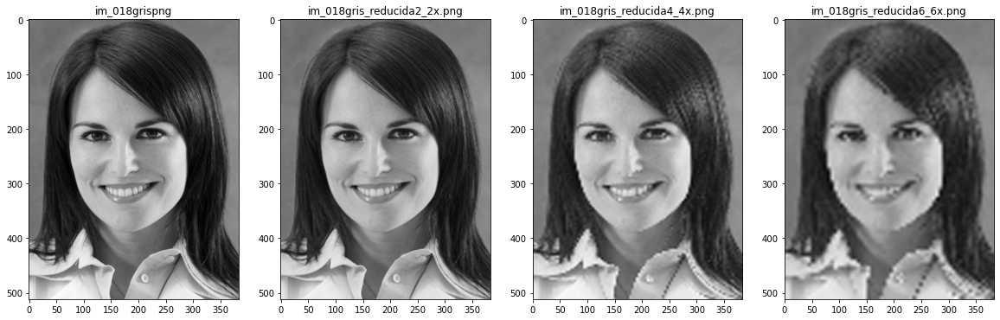

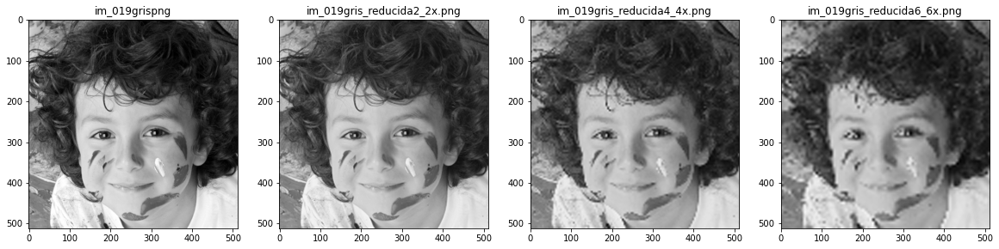

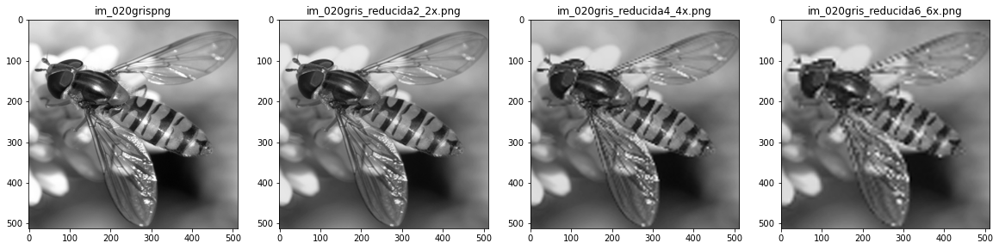

In [5]:
mostrar_imagen_4f(18,21,'general100mod128','gris',
                  'general100mod128','gris_reducida2_2x',
                  'general100mod128','gris_reducida4_4x',
                  'general100mod128','gris_reducida6_6x')

# Preparar imágenes para pruebas con otros conjuntos de datos

In [4]:
#Nota: La prueba se realizo en una reduccion de 4x. Se deja el codigo para 2x comentado como ejemplo para probar con otras reducciones
def procesar_imagenes_PruebaRODIUCAN(xposini,xposfin,xcarpeta_img_original,xcarpeta_img,xnom_img1,xnom_img1color,xnom_img3,xnom_img3color,crear_nearest=False):
    for i in range(xposini,xposfin):
        img = cv2.imread(xcarpeta_img_original+'/'+getNombreArchivo(i)+'.png')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        #Redimensionar a multiplo TAM_PARCHExTAM_PARCHE
        tamsegy=int(img.shape[0]/TAM_PARCHE)+1
        tamsegx=int(img.shape[1]/TAM_PARCHE)+1
        nuevoy=tamsegy*TAM_PARCHE
        nuevox=tamsegx*TAM_PARCHE
        img2 = cv2.resize(img, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)    
        #Convertir a grises y guardar
        r,g,b=img2[:,:,0],img2[:,:,1],img2[:,:,2]
        egrises=0.2989*r+0.5870*g+0.1140*b
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img1+'.png',egrises,cmap='gray')
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img1color+'.png',img2)
        
        #----------Reducir a la cuarta 4x y reescalada a 4x
        img5 = cv2.resize(egrises, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_CUBIC)
        img6 = cv2.resize(img5, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img5nearest = cv2.resize(egrises, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_NEAREST)
        img6nearest = cv2.resize(img5nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3+'.png',img6,cmap='gray')
        if(crear_nearest==True):
            plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3+'nearest.png',img6nearest,cmap='gray')
        img5 = cv2.resize(img2, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_CUBIC)
        img6 = cv2.resize(img5, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)
        img5nearest = cv2.resize(img2, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_NEAREST)
        img6nearest = cv2.resize(img5nearest, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_NEAREST)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3color+'.png',img6)
        if(crear_nearest==True):
            plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3color+'nearest.png',img6nearest)



In [8]:
procesar_imagenes_PruebaRODIUCAN(1,101,'pruebas/BSDS100','pruebas/BSDS100mod128',
                  'gris','color',
                  'gris_reducida4_4x','color_reducida4_4x')

In [9]:
procesar_imagenes_PruebaRODIUCAN(1,41,'pruebas/Historicas40','pruebas/Historicas40mod128',
                  'gris','color',
                  'gris_reducida4_4x','color_reducida4_4x')

In [10]:
procesar_imagenes_PruebaRODIUCAN(1,110,'pruebas/Manga109','pruebas/Manga109mod128',
                  'gris','color',
                  'gris_reducida4_4x','color_reducida4_4x')

In [7]:
procesar_imagenes_PruebaRODIUCAN(1,6,'pruebas/Set5','pruebas/Set5mod128',
                  'gris','color',
                  'gris_reducida4_4x','color_reducida4_4x',True)

In [6]:
procesar_imagenes_PruebaRODIUCAN(1,15,'pruebas/Set14','pruebas/Set14mod128',
                  'gris','color',
                  'gris_reducida4_4x','color_reducida4_4x',True)

In [11]:
procesar_imagenes_PruebaRODIUCAN(1,101,'pruebas/Urban100','pruebas/Urban100mod128',
                  'gris','color',
                  'gris_reducida4_4x','color_reducida4_4x')

# Aplicar el automata a las imagenes

In [10]:
#Procesamiento normal (usar en caso de que el procesamiento en paralelo no funcione correctamente)
#aplicar_automata6var(1,301,'general100mod128','gris',
#                     'general100mod128','gris_mapa',
#                     'general100mod128secuencia','gris_mapa',5)

In [8]:
#Procesamiento en paralelo
def aplicar_automata6var_MultiProceso(i):
    aplicar_automata6var(i,i+1,'general100mod128','gris',
                     'general100mod128','gris_mapa',
                     'general100mod128secuencia','gris_mapa',5)
    return i
inicio = timeit.default_timer()
n_jobs = multiprocessing.cpu_count()-1
res=Parallel(n_jobs=n_jobs)(delayed(aplicar_automata6var_MultiProceso)(i) for i in range(1,301))
fin = timeit.default_timer()
print(fin-inicio)

1753.3043521000002


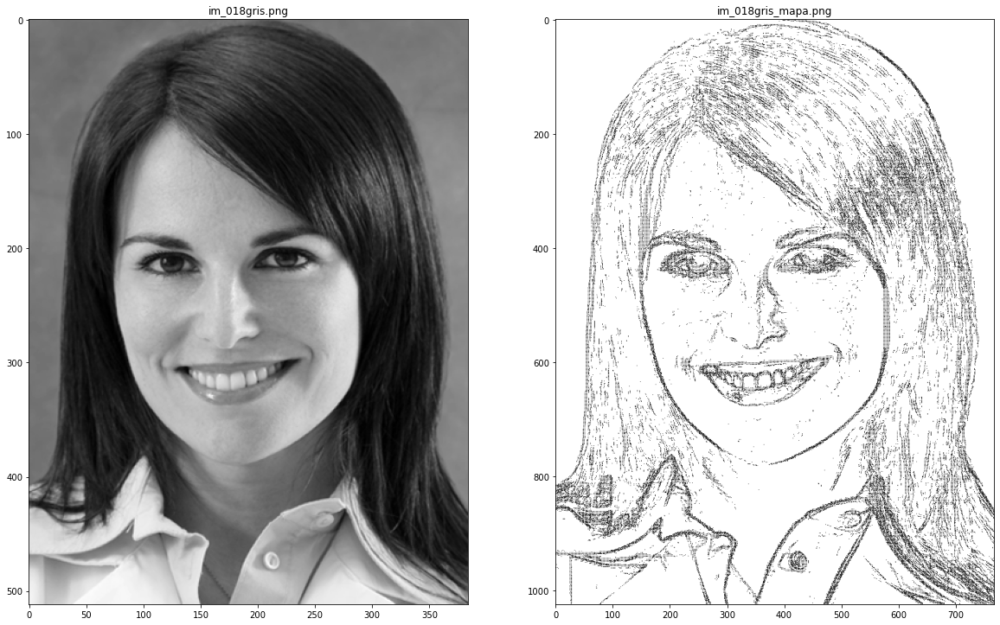

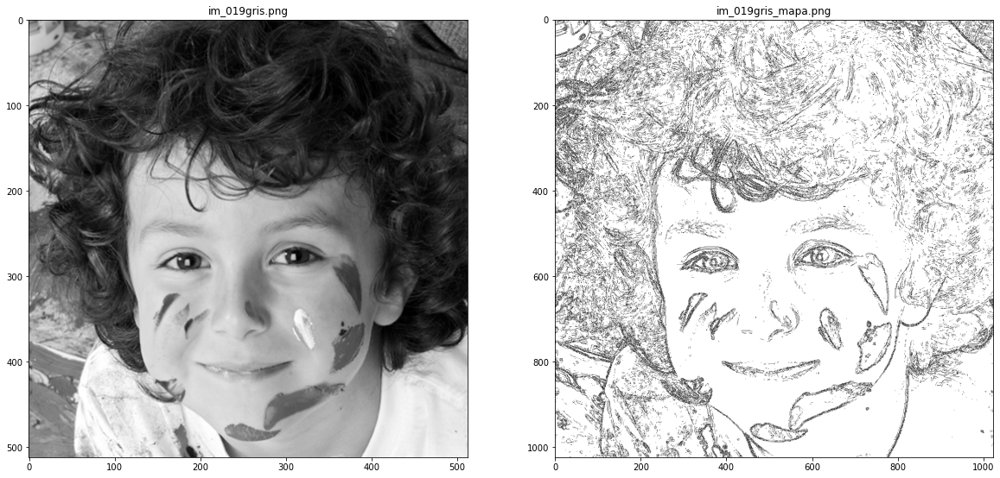

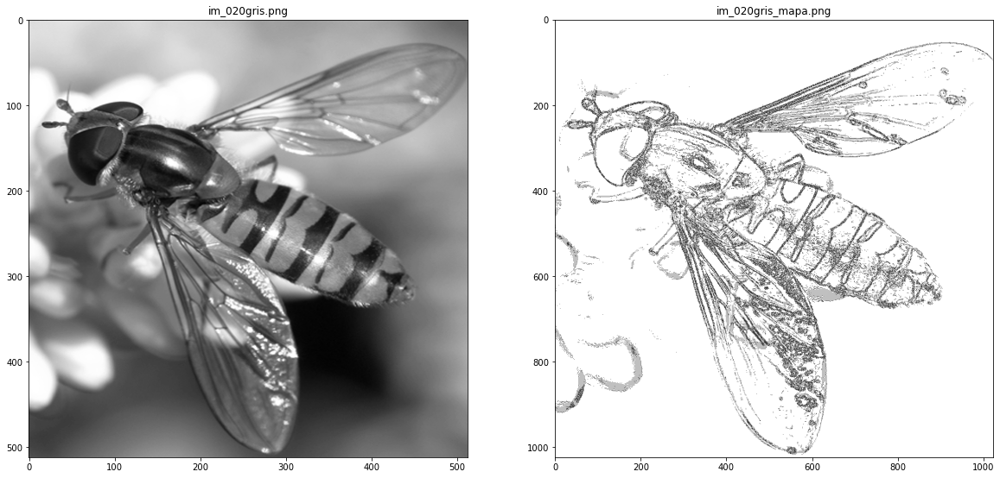

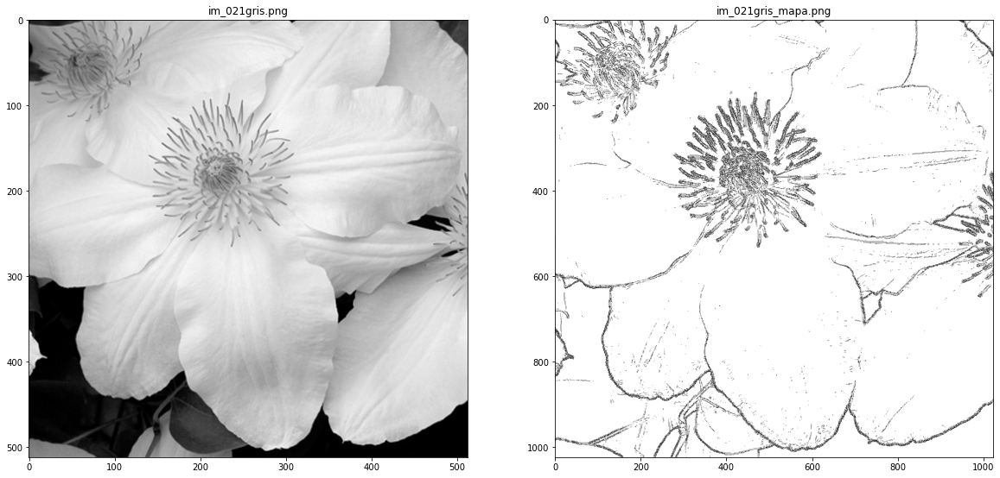

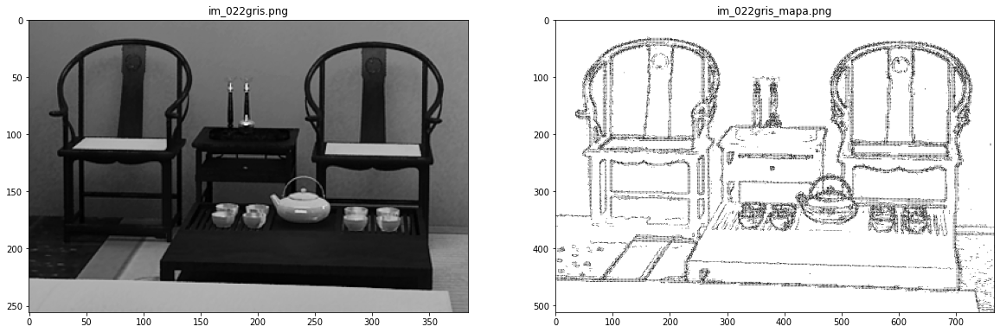

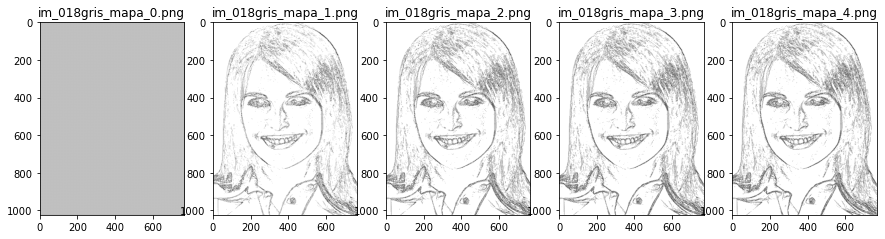

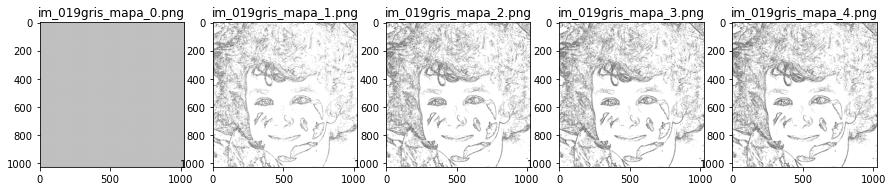

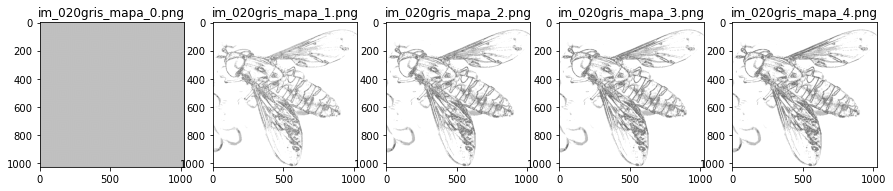

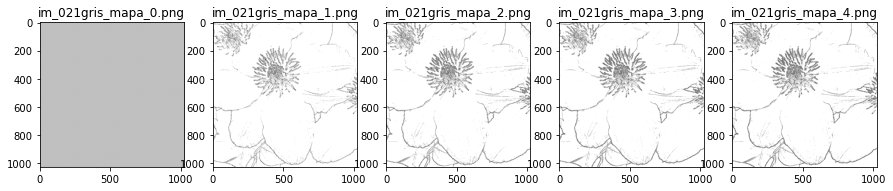

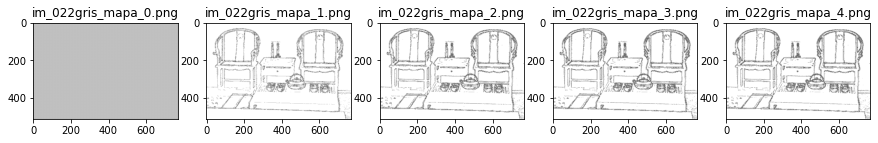

In [4]:
mostrar_imagen_2f(18,23,'general100mod128','gris',
                  'general100mod128','gris_mapa')
mostrar_imagen_secuencia_ac(18,23,'general100mod128secuencia','gris_mapa',5)

In [ ]:
#Procesamiento normal (usar en caso de que el procesamiento en paralelo no funcione correctamente)
#aplicar_automata6varRGB(1,301,'general100mod128','color',
#                     'general100mod128','color_mapa',
#                     'general100mod128secuencia','color_mapa',5)

In [4]:
#Procesamiento en paralelo
def aplicar_automata6var_MultiProcesoRGB(i):
    aplicar_automata6varRGB(i,i+1,'general100mod128','color',
                     'general100mod128','color_mapa',
                     'general100mod128secuencia','color_mapa',5)
    return i
inicio = timeit.default_timer()
n_jobs = multiprocessing.cpu_count()-1
res=Parallel(n_jobs=n_jobs)(delayed(aplicar_automata6var_MultiProcesoRGB)(i) for i in range(1,301))
fin = timeit.default_timer()
print(fin-inicio)

13119.323667899938


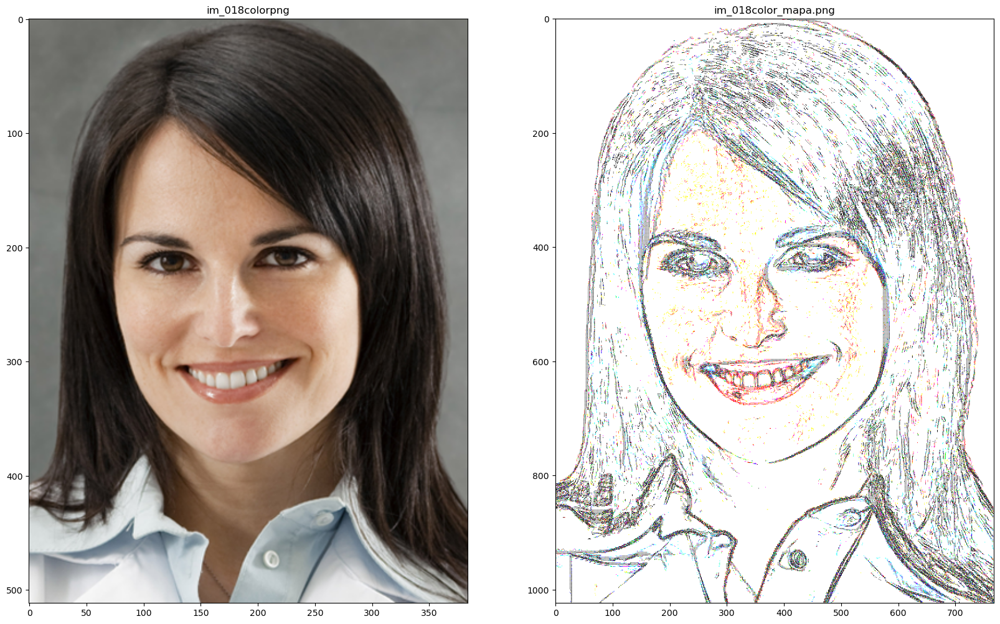

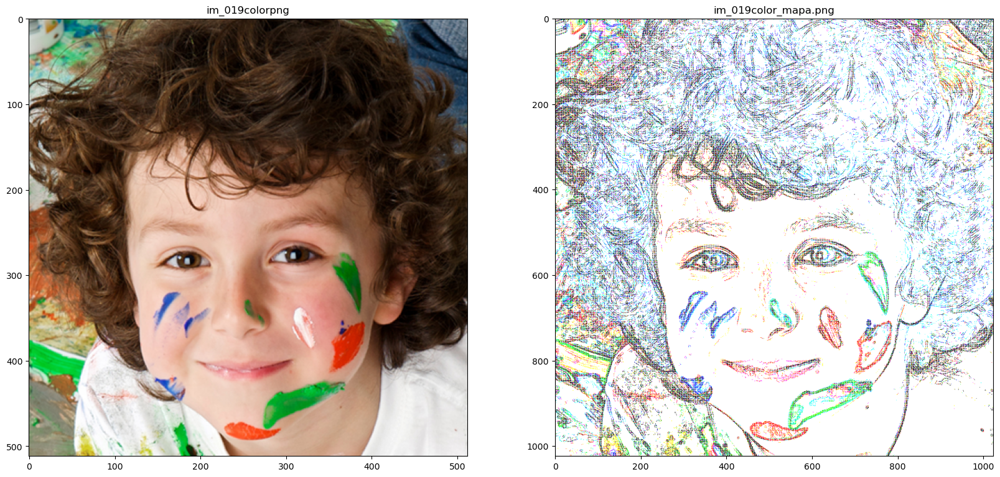

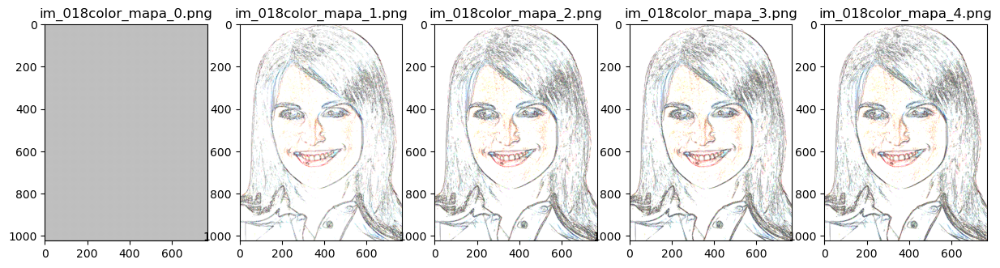

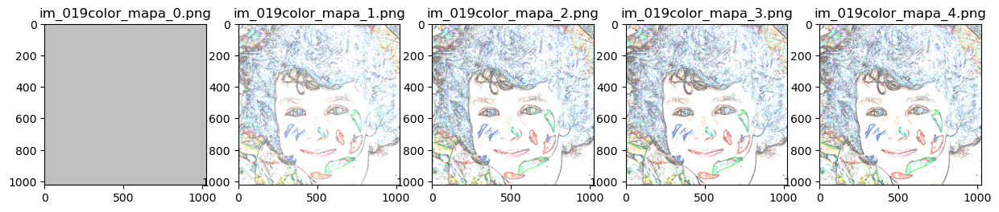

In [5]:
mostrar_imagen_2f_RGB(18,20,'general100mod128','color',
                  'general100mod128','color_mapa')
mostrar_imagen_secuencia_acRGB(18,20,'general100mod128secuencia','color_mapa',5)

# Aplicar el automata INVERSO a las imagenes

In [ ]:
#Procesamiento normal (usar en caso de que el procesamiento en paralelo no funcione correctamente)
#aplicar_automata6var_inverso(1,301,'general100mod128','gris',
#                             'general100mod128','gris_mapaINV',
#                             'general100mod128secuencia','gris_mapaINV',5)

In [10]:
#Procesamiento en paralelo
def aplicar_automata6var_inverso_MultiProceso(i):
    aplicar_automata6var_inverso(i,i+1,'general100mod128','gris',
                             'general100mod128','gris_mapaINV',
                             'general100mod128secuencia','gris_mapaINV',5)
    return i
inicio = timeit.default_timer()
n_jobs = multiprocessing.cpu_count()-1
res=Parallel(n_jobs=n_jobs)(delayed(aplicar_automata6var_inverso_MultiProceso)(i) for i in range(1,301))
fin = timeit.default_timer()
print(fin-inicio)

1566.2809047


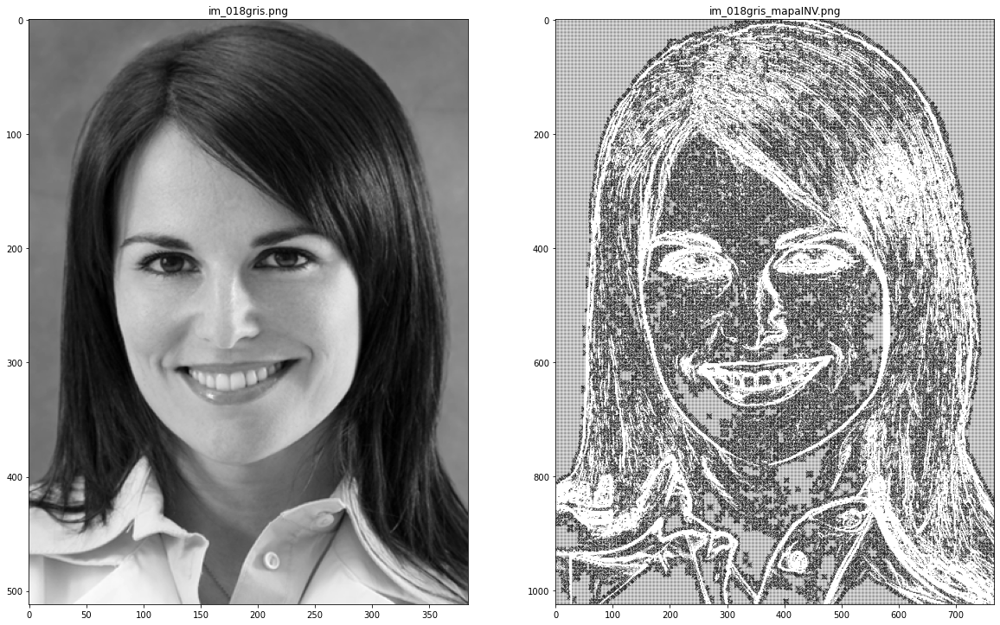

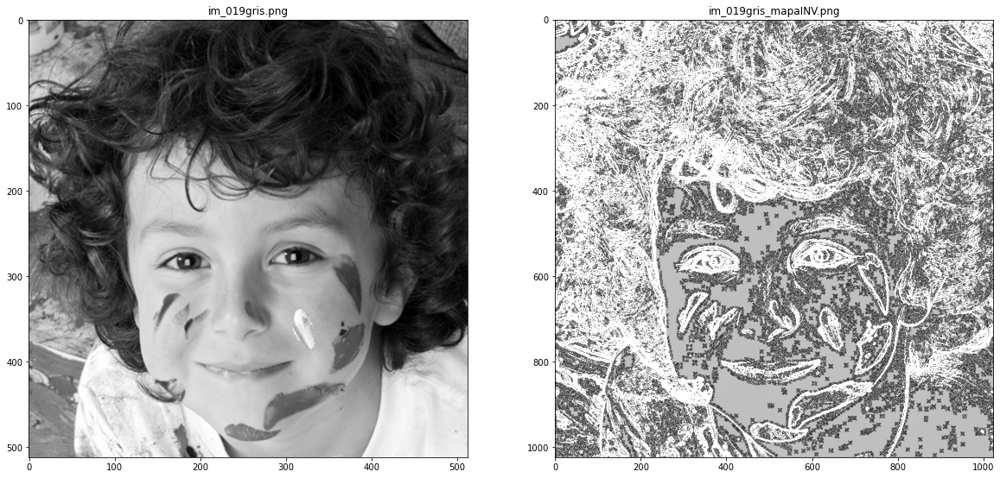

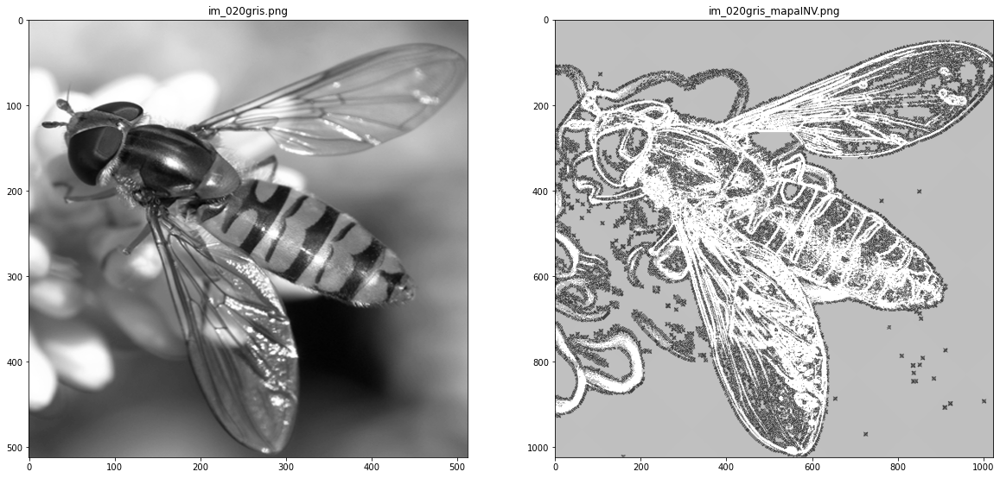

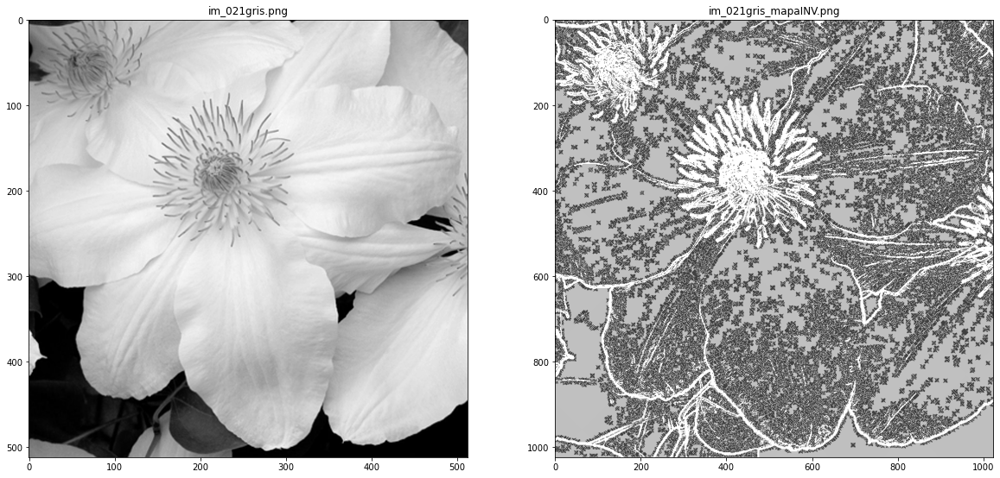

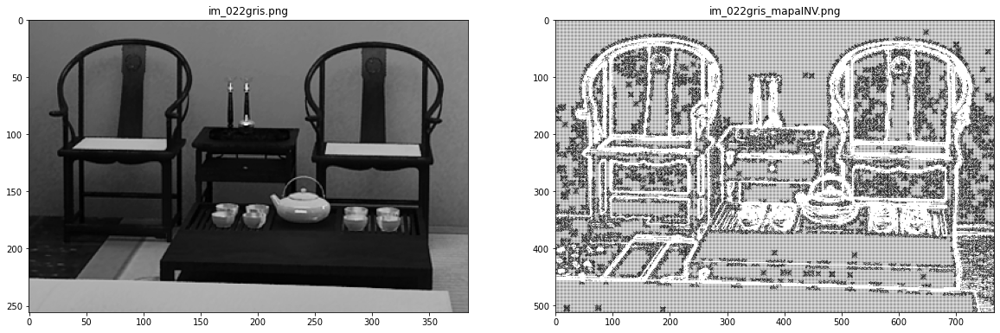

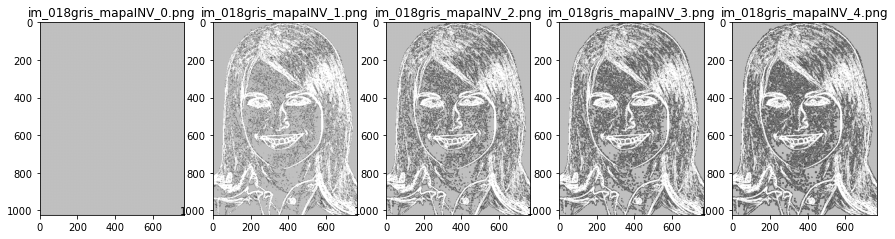

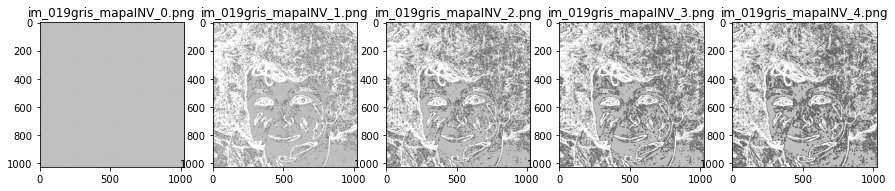

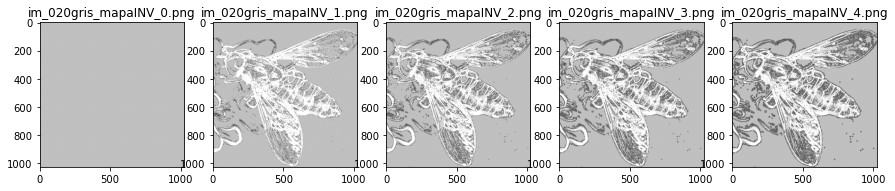

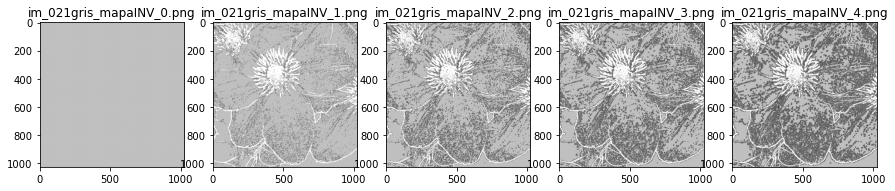

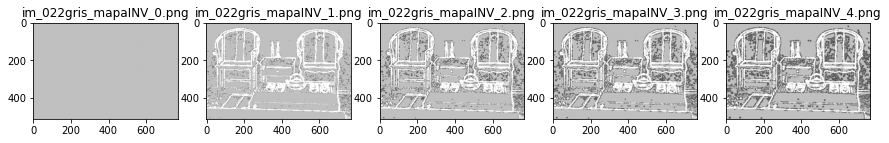

In [7]:
mostrar_imagen_2f(18,23,'general100mod128','gris',
                  'general100mod128','gris_mapaINV')
mostrar_imagen_secuencia_ac(18,23,'general100mod128secuencia','gris_mapaINV',5)

In [ ]:
#Procesamiento normal (usar en caso de que el procesamiento en paralelo no funcione correctamente)
#aplicar_automata6var_inversoRGB(1,301,'general100mod128','color',
#                             'general100mod128','color_mapaINV',
#                             'general100mod128secuencia','color_mapaINV',5)

In [6]:
#Procesamiento en paralelo
def aplicar_automata6var_inverso_MultiProcesoRGB(i):
    aplicar_automata6var_inversoRGB(i,i+1,'general100mod128','color',
                             'general100mod128','color_mapaINV',
                             'general100mod128secuencia','color_mapaINV',5)
    return i
inicio = timeit.default_timer()
n_jobs = multiprocessing.cpu_count()-1
res=Parallel(n_jobs=n_jobs)(delayed(aplicar_automata6var_inverso_MultiProcesoRGB)(i) for i in range(1,301))
fin = timeit.default_timer()
print(fin-inicio)

13333.889646299998


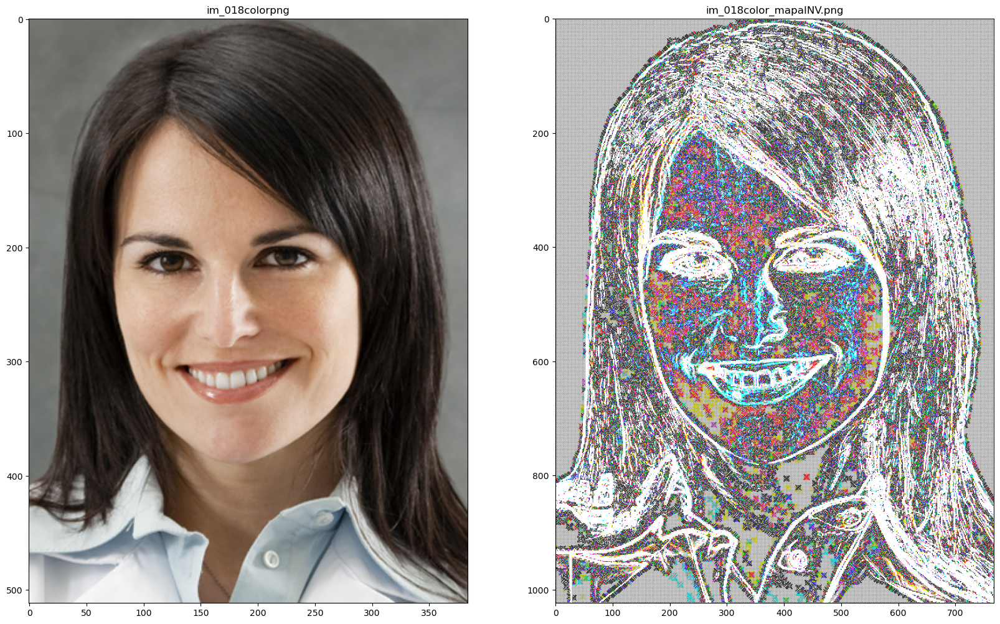

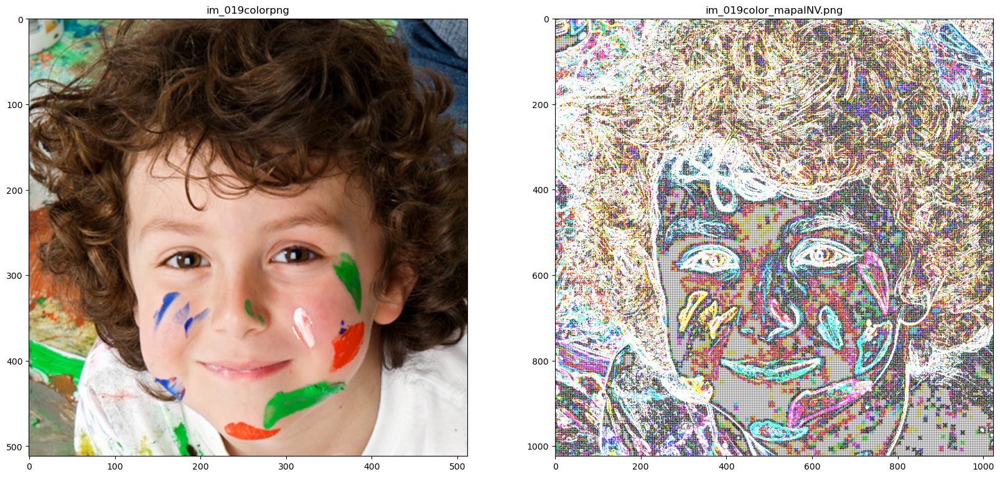

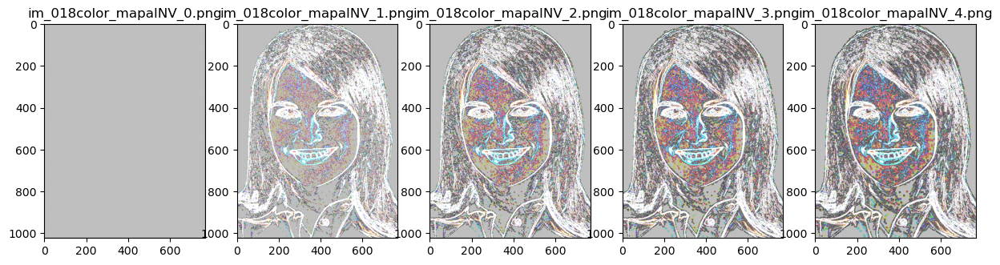

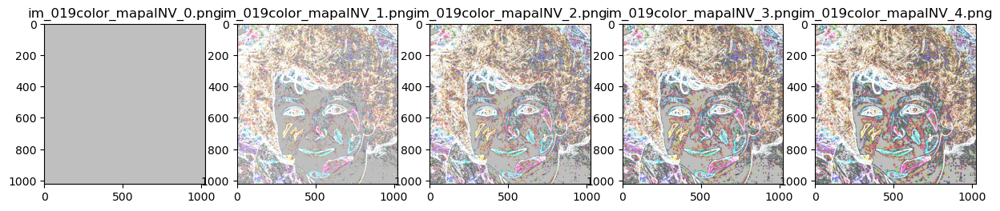

In [8]:
mostrar_imagen_2f_RGB(18,20,'general100mod128','color',
                  'general100mod128','color_mapaINV')
mostrar_imagen_secuencia_acRGB(18,20,'general100mod128secuencia','color_mapaINV',5)

# Combinar imágenes de los dos autómatas

In [5]:
#Procesamiento normal (usar en caso de que el procesamiento en paralelo no funcione correctamente)
#combinar_automata6var(1,301,'general100mod128','gris_mapa',
#                      'general100mod128','gris_mapaINV',
#                      'general100mod128','gris_mapaCOMB')

In [12]:
#Procesamiento en paralelo
def combinar_automata6var_MultiProceso(i):
    combinar_automata6var(i,i+1,'general100mod128','gris_mapa',
                      'general100mod128','gris_mapaINV',
                      'general100mod128','gris_mapaCOMB')
    return i
inicio = timeit.default_timer()
n_jobs = multiprocessing.cpu_count()-1
res=Parallel(n_jobs=n_jobs)(delayed(combinar_automata6var_MultiProceso)(i) for i in range(1,301))
fin = timeit.default_timer()
print(fin-inicio)

230.21447230000012


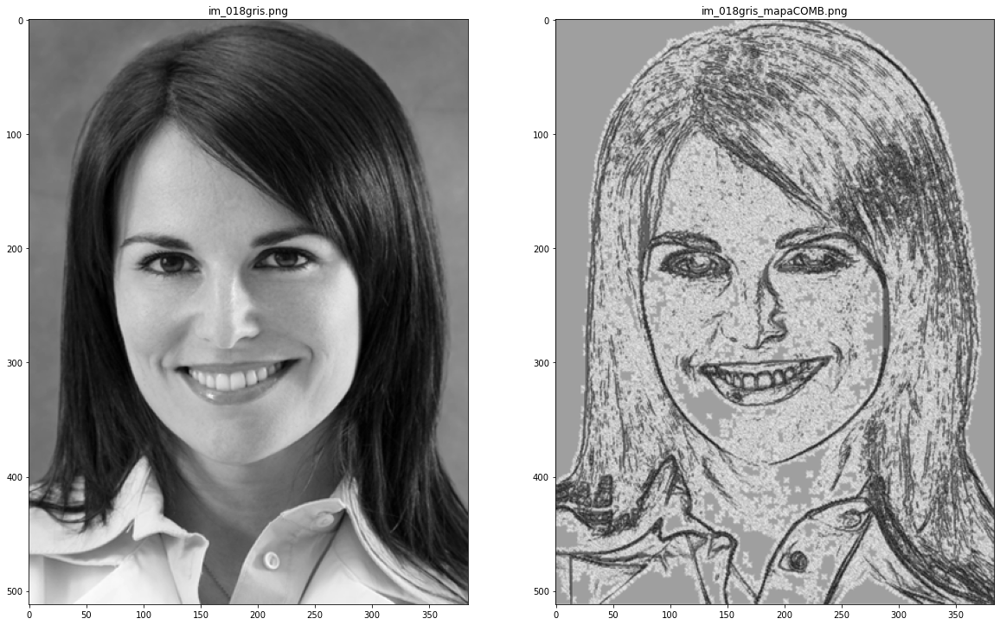

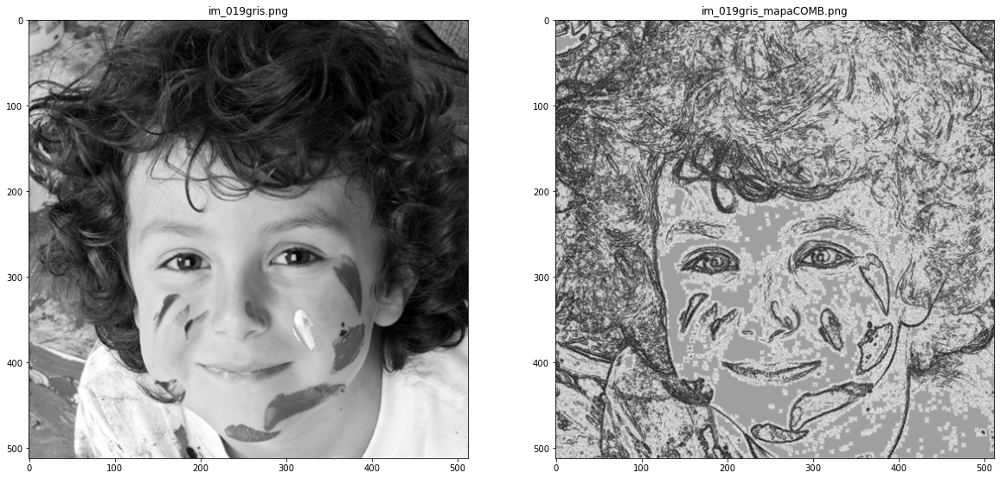

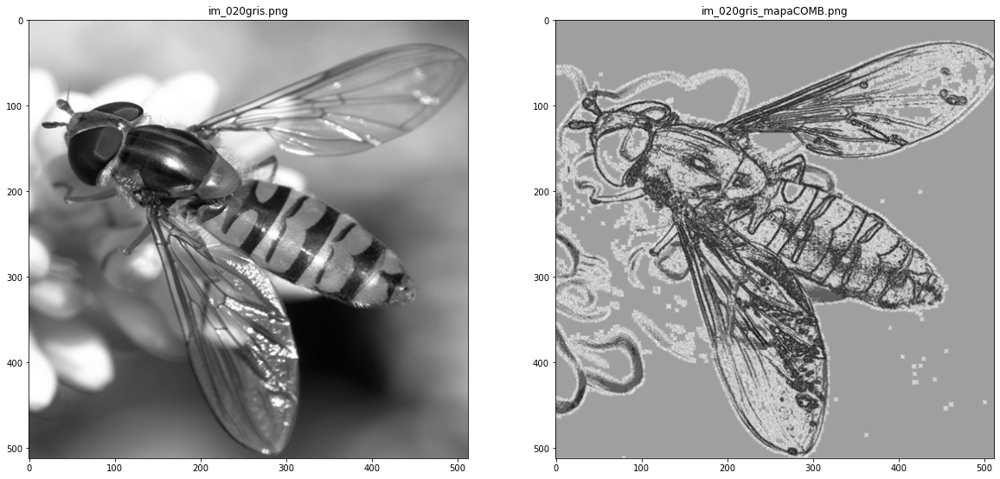

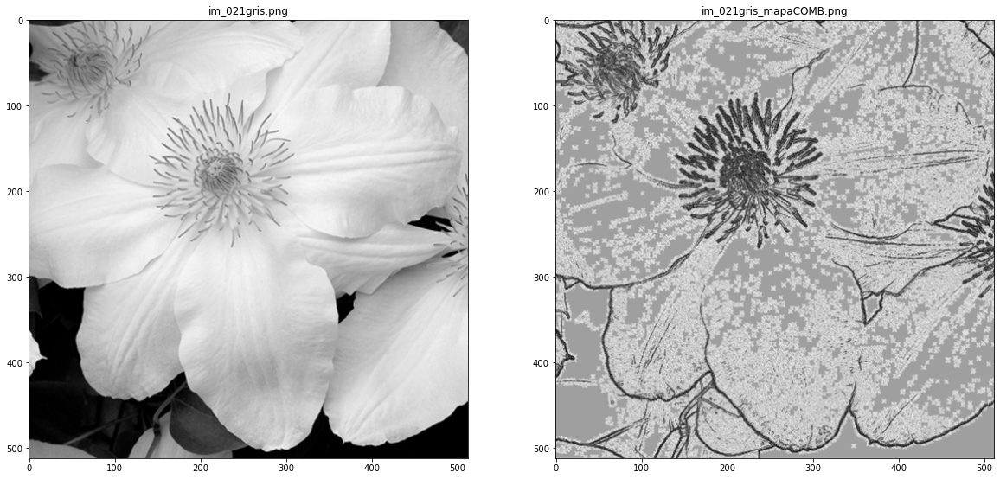

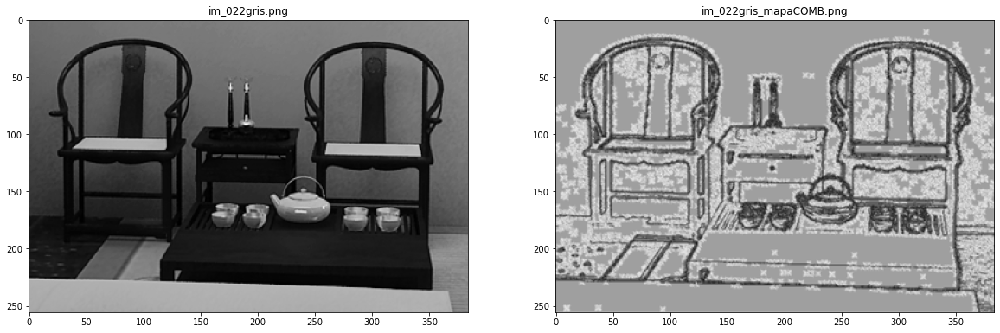

In [36]:
mostrar_imagen_2f(18,23,'general100mod128','gris',
                  'general100mod128','gris_mapaCOMB')

In [ ]:
#Procesamiento normal (usar en caso de que el procesamiento en paralelo no funcione correctamente)
#combinar_automata6varRGB(1,301,'general100mod128','color_mapa',
#                      'general100mod128','color_mapaINV',
#                      'general100mod128','color_mapaCOMB')

In [9]:
#Procesamiento en paralelo
def combinar_automata6var_MultiProcesoRGB(i):
    combinar_automata6varRGB(i,i+1,'general100mod128','color_mapa',
                      'general100mod128','color_mapaINV',
                      'general100mod128','color_mapaCOMB')
    return i
inicio = timeit.default_timer()
n_jobs = multiprocessing.cpu_count()-1
res=Parallel(n_jobs=n_jobs)(delayed(combinar_automata6var_MultiProcesoRGB)(i) for i in range(1,301))
fin = timeit.default_timer()
print(fin-inicio)

2101.608651900082


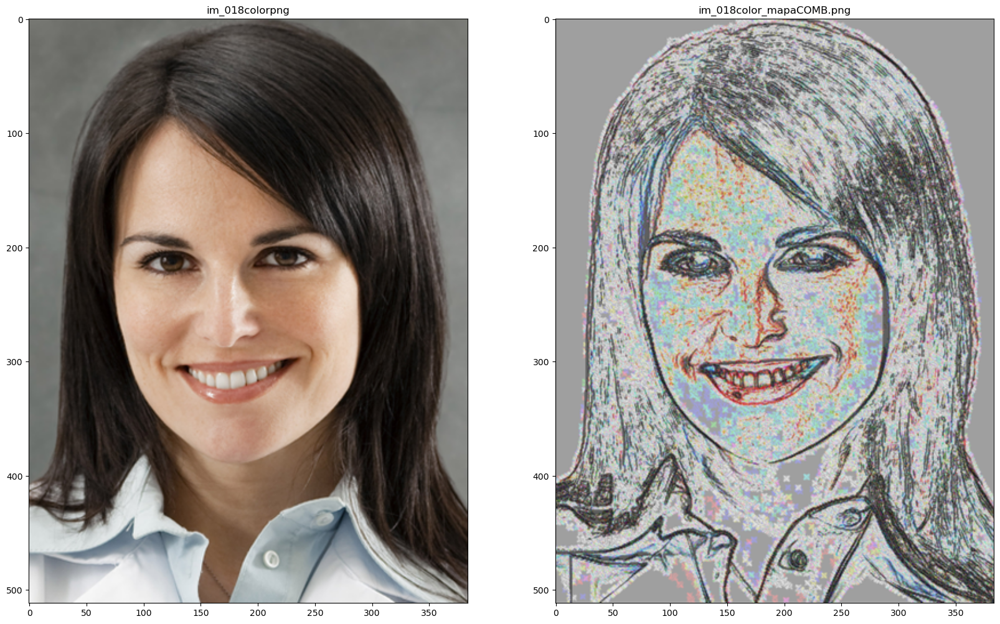

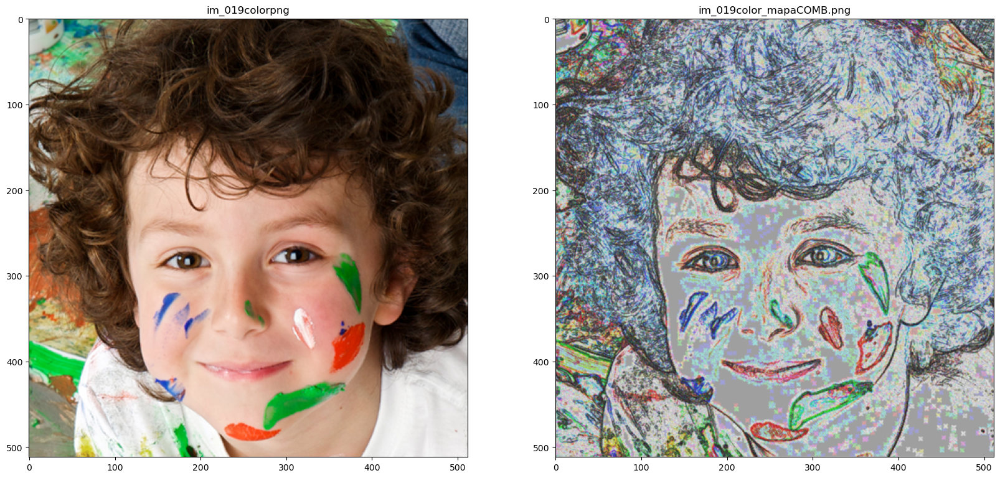

In [10]:
mostrar_imagen_2f_RGB(18,20,'general100mod128','color',
                  'general100mod128','color_mapaCOMB')

# Preparar imágenes para pruebas con otros conjuntos de datos(ESRGAN)

In [6]:
#---------------------------FUNCION PROCESAMIENTO DE IMAGENES DE PRUEBA CON esrgan
def procesar_imagenes_PruebaSRGAN(xposini,xposfin,xcarpeta_img_original,xcarpeta_img,xnom_img3,xnom_img3color):
    for i in range(xposini,xposfin):
        img = cv2.imread(xcarpeta_img_original+'/'+getNombreArchivo(i)+'.png')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        #Redimensionar a multiplo TAM_PARCHExTAM_PARCHE
        tamsegy=int(img.shape[0]/TAM_PARCHE)+1
        tamsegx=int(img.shape[1]/TAM_PARCHE)+1
        nuevoy=tamsegy*TAM_PARCHE
        nuevox=tamsegx*TAM_PARCHE
        img2 = cv2.resize(img, dsize=(nuevox,nuevoy), interpolation=cv2.INTER_CUBIC)    
        #Convertir a grises y guardar
        r,g,b=img2[:,:,0],img2[:,:,1],img2[:,:,2]
        egrises=0.2989*r+0.5870*g+0.1140*b
                
        #----------Reducir a la cuarta 4x
        img5 = cv2.resize(egrises, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_CUBIC)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3+'r4.png',img5,cmap='gray')
        img5 = cv2.resize(img2, dsize=(int(nuevox/4),int(nuevoy/4)), interpolation=cv2.INTER_CUBIC)
        plt.imsave(xcarpeta_img+'/'+getNombreArchivo(i)+xnom_img3color+'r4.png',img5)
        

In [18]:
procesar_imagenes_PruebaSRGAN(1,101,'pruebas/BSDS100','pruebasSRGAN/BSDS100mod128',
                  'gris_reducida4_4x','color_reducida4_4x')

In [7]:
procesar_imagenes_PruebaSRGAN(1,41,'pruebas/Historicas40','pruebasSRGAN/Historicas40mod128',
                  'gris_reducida4_4x','color_reducida4_4x')

In [16]:
procesar_imagenes_PruebaSRGAN(1,110,'pruebas/Manga109','pruebasSRGAN/Manga109mod128',
                  'gris_reducida4_4x','color_reducida4_4x')

In [13]:
procesar_imagenes_PruebaSRGAN(1,6,'pruebas/Set5','pruebasSRGAN/Set5mod128',
                  'gris_reducida4_4x','color_reducida4_4x')

In [14]:
procesar_imagenes_PruebaSRGAN(1,15,'pruebas/Set14','pruebasSRGAN/Set14mod128',
                  'gris_reducida4_4x','color_reducida4_4x')

In [15]:
procesar_imagenes_PruebaSRGAN(1,101,'pruebas/Urban100','pruebasSRGAN/Urban100mod128',
                  'gris_reducida4_4x','color_reducida4_4x')

Una vez que las imagenes fueron generadas en el directorio pruebasSRGAN y sus respectivos subdirectorios.
Estas fueron optimizados con la herramienta Cupscale 1.39.0f1 y fueron guardadas en los subdirectorios:

* pruebasSRGAN/BSDS100resultado128
* pruebasSRGAN/Historicas40resultado128
* pruebasSRGAN/Manga109resultado128
* pruebasSRGAN/Set5resultado128
* pruebasSRGAN/Set14resultado128
* pruebasSRGAN/Urban100resultado128


# Desmontar drive google

In [ ]:
drive.flush_and_unmount()